#Active Classification: pool-based sampling, uncertainty sampling and query by committee

##**Author: Kuba Czech, 156035**##

In [92]:
#!pip install modAL
!pip install modAL-python

# Pool-based sampling

## Overview

In this example, we apply an `ActiveLearner` onto the iris dataset using pool-based sampling. In this setting, we assume a small set of labeled data $\mathcal{L}$ and a large set of unlabeled data $\mathcal{U}$ such that $\left| \mathcal{L} \right| \ll \left| \mathcal{U} \right|$. In his review of the active learning literature, Settles covers a high-level overview of the general pool-based sampling algorithm:

> Queries are selectively drawn from the pool, which is usually assumed to be closed (i.e., static or non-changing), although this is not strictly necessary. Typically, instances are queried in a greedy fashion, according to an informativeness measure used to evaluate all instances in the pool (or, perhaps if $\mathcal{U}$ is very large, some subsample thereof).

Along with our pool-based sampling strategy, `modAL`'s modular design allows you to vary parameters surrounding the active learning process, including the core estimator and query strategy. In this example, we use `scikit-learn`'s [k-nearest neighbors classifier](http://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html) as our estimator and default to `modAL`'s [uncertainty sampling](https://cosmic-cortex.github.io/modAL/Uncertainty-sampling) query strategy.

For further reading on pool-based sampling, we highly recommend the following resources:
- Burr Settles. [Active Learning Literature Survey](http://burrsettles.com/pub/settles.activelearning.pdf) [**Section 2.3: Pool-based Sampling**]. Computer Sciences Technical Report 1648, University of Wisconsin-Madison. 2009.

To enforce a reproducible result across runs, we set a random seed.

In [93]:
import numpy as np

# Set our RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

## The dataset

Now we load the dataset. In this example, we are going to use the famous Iris dataset. For more information on the iris dataset, see:
  - [The dataset documentation on Wikipedia](https://en.wikipedia.org/wiki/Iris_flower_data_set)
  - [The scikit-learn interface](http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_iris.html)

In [94]:
from sklearn.datasets import load_iris

iris = load_iris()
X_raw = iris['data']
y_raw = iris['target']

For visualization purposes, we apply PCA to the original dataset.

In [95]:
from sklearn.decomposition import PCA

# Define our PCA transformer and fit it onto our raw dataset.
pca = PCA(n_components=2, random_state=RANDOM_STATE_SEED)
transformed_iris = pca.fit_transform(X=X_raw)

This is how the dataset looks like.

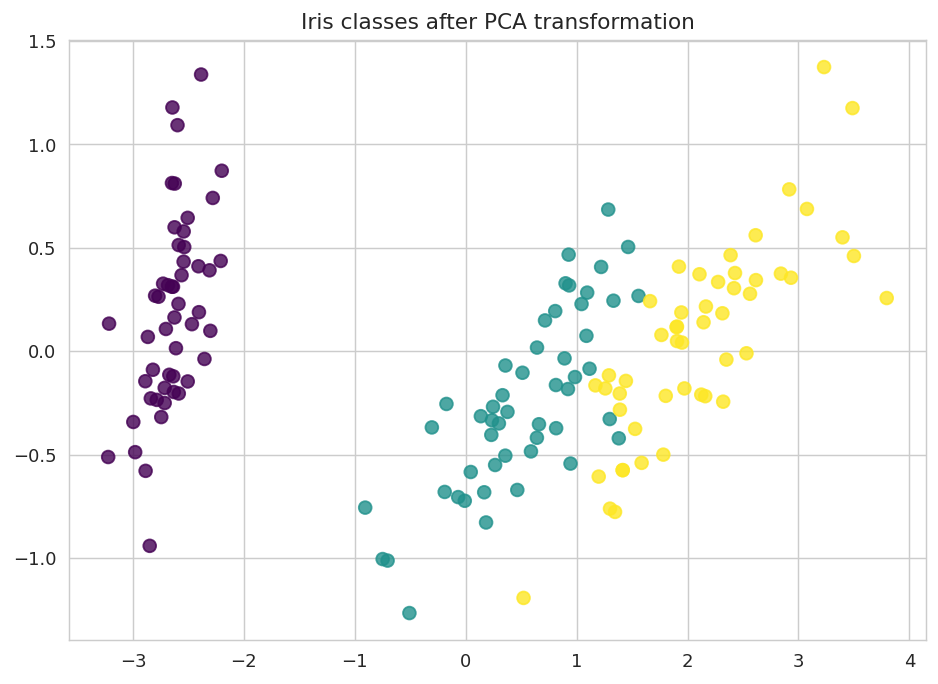

In [96]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

# Isolate the data we'll need for plotting.
x_component, y_component = transformed_iris[:, 0], transformed_iris[:, 1]

# Plot our dimensionality-reduced (via PCA) dataset.
plt.figure(figsize=(8.5, 6), dpi=130)
plt.scatter(x=x_component, y=y_component, c=y_raw, cmap='viridis', s=50, alpha=8/10)
plt.title('Iris classes after PCA transformation')
plt.show()

Now we partition our `iris` dataset into a training set $\mathcal{L}$ and $\mathcal{U}$. We first specify our training set $\mathcal{L}$ consisting of 3 random examples. The remaining examples go to our "unlabeled" pool $\mathcal{U}$.

In [97]:
# Isolate our examples for our labeled dataset.
n_labeled_examples = X_raw.shape[0]
#training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

X_train = X_raw[training_indices]
y_train = y_raw[training_indices]

# Isolate the non-training examples we'll be querying.
X_pool = np.delete(X_raw, training_indices, axis=0)
y_pool = np.delete(y_raw, training_indices, axis=0)

In [98]:
X_train.shape

(3, 4)

In [99]:
y_train.shape

(3,)

## Active learning with pool-based sampling

For the classification, we are going to use a simple k-nearest neighbors classifier. In this step, we are also going to initialize the ```ActiveLearner```.

In [100]:
from sklearn.neighbors import KNeighborsClassifier
from modAL.models import ActiveLearner

# Specify our core estimator along with it's active learning model.
knn = KNeighborsClassifier(n_neighbors=3)
learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

"To create an ActiveLearner object, you need to provide two things: a scikit-learn estimator object and a query strategy function (The latter one is optional, the default strategy is maximum uncertainty sampling.). Regarding the query strategies, you can find built-ins in modAL.uncertainty, but you can also implement your own. For instance, you can just simply do the following.

    from modAL.models import ActiveLearner
    from modAL.uncertainty import uncertainty_sampling
    from sklearn.ensemble import RandomForestClassifier

    learner = ActiveLearner(
        estimator=RandomForestClassifier(),
        query_strategy=uncertainty_sampling
    )

In modAL, currently there are three built-in query strategies: max uncertainty, max margin and max entropy(...)"

[https://github.com/modAL-python/modAL/blob/99d4947f69f0b2247f9916a6ef44463f7af06c55/docs/source/content/models/ActiveLearner.rst]

Let's see how our classifier performs on the initial training set!

In [101]:
# Isolate the data we'll need for plotting.
predictions = learner.predict(X_raw)
is_correct = (predictions == y_raw)

predictions

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

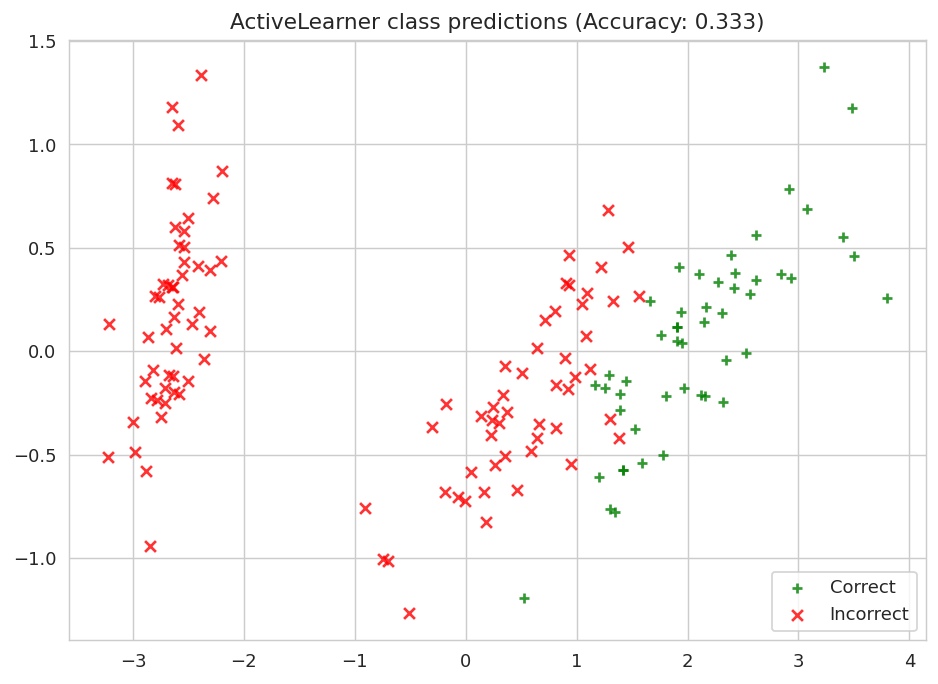

In [102]:
# Record our learner's score on the raw data.
unqueried_score = learner.score(X_raw, y_raw)

# Plot our classification results.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
ax.scatter(x=x_component[is_correct],  y=y_component[is_correct],  c='g', marker='+', label='Correct',   alpha=8/10)
ax.scatter(x=x_component[~is_correct], y=y_component[~is_correct], c='r', marker='x', label='Incorrect', alpha=8/10)
ax.legend(loc='lower right')
ax.set_title("ActiveLearner class predictions (Accuracy: {score:.3f})".format(score=unqueried_score))
plt.show()

## Update our model by pool-based sampling our "unlabeled" dataset $\mathcal{U}$

As we can see, our model is unable to properly learn the underlying data distribution. All of its predictions are for the third class label, and as such it is only as competitive as defaulting its predictions to a single class – if only we had more data!

Below, we tune our classifier by allowing it to query 20 instances it hasn't seen before. Using uncertainty sampling, our classifier aims to reduce the amount of uncertainty in its predictions using a variety of measures — see the documentation for more on specific [classification uncertainty measures](https://modal-python.readthedocs.io/en/latest/content/query_strategies/Uncertainty-sampling.html). With each requested query, we remove that record from our pool $\mathcal{U}$ and record our model's accuracy on the raw dataset.

In [103]:
N_QUERIES = 20
performance_history = [unqueried_score]

# Allow our model to query our unlabeled dataset for the most
# informative points according to our query strategy (uncertainty sampling).
for index in range(N_QUERIES):
  query_index, query_instance = learner.query(X_pool)

  # Teach our ActiveLearner model the record it has requested.
  X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
  print("X type: ", type(X))
  print("X shape: ", X.shape)
  print("y shape: ", y.shape)
  learner.teach(X=X, y=y)

  learner_X_training = learner.X_training
  print("learner_X_training type: ", type(learner_X_training))
  print("learner_X_training shape: ", learner_X_training.shape)
  print("learner_X_training shape: ", learner_X_training.shape)

  # Remove the queried instance from the unlabeled pool.
  X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
  print("X_pool type: ", type(X_pool))
  print("X_pool shape: ", X_pool.shape)
  print("y_pool shape: ", y_pool.shape)

  # Calculate and report our model's accuracy.
  model_accuracy = learner.score(X_raw, y_raw)
  print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))
  print("X_raw type: ", type(X_raw))
  print("X_raw shape: ", X_raw.shape)
  print("y_raw shape: ", y_raw.shape)


  # Save our model's performance for plotting.
  performance_history.append(model_accuracy)

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6667
X_raw type:  <class 'numpy.ndarray'>
X_raw shape:  (150, 4)
y_raw shape:  (150,)
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6667
X_raw type:  <class 'numpy.ndarray'>
X_raw shape:  (150, 4)
y_raw shape:  (150,)
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

## Evaluate our model's performance

Here, we first plot the query iteration index against model accuracy. To visualize the performance of our classifier, we also plot the correct and incorrect predictions on the full dataset.

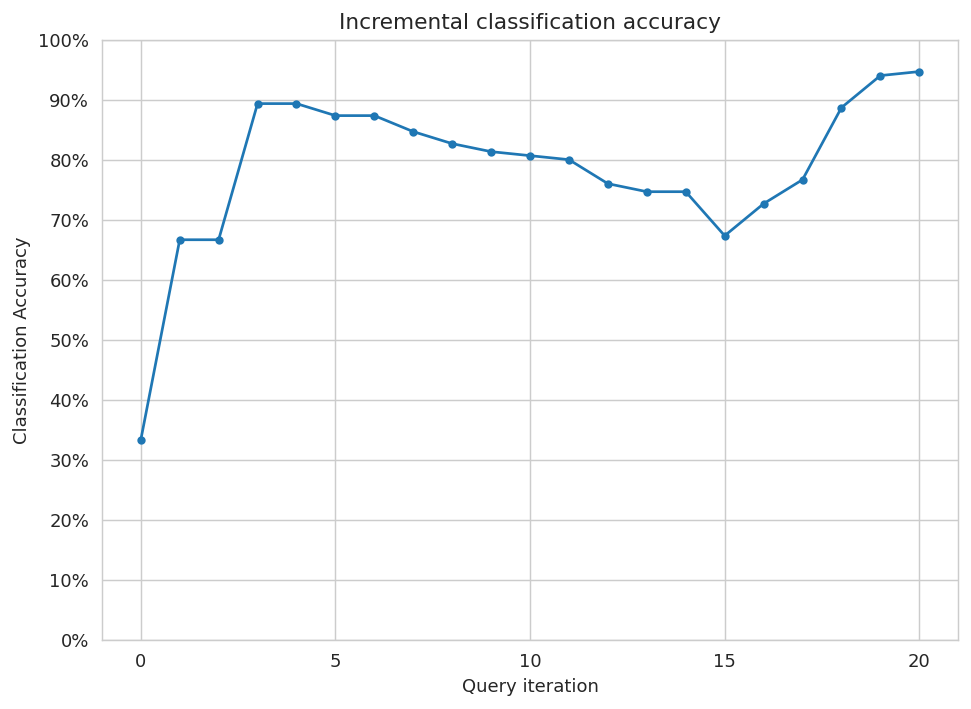

In [104]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.plot(performance_history)
ax.scatter(range(len(performance_history)), performance_history, s=13)

ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')

plt.show()

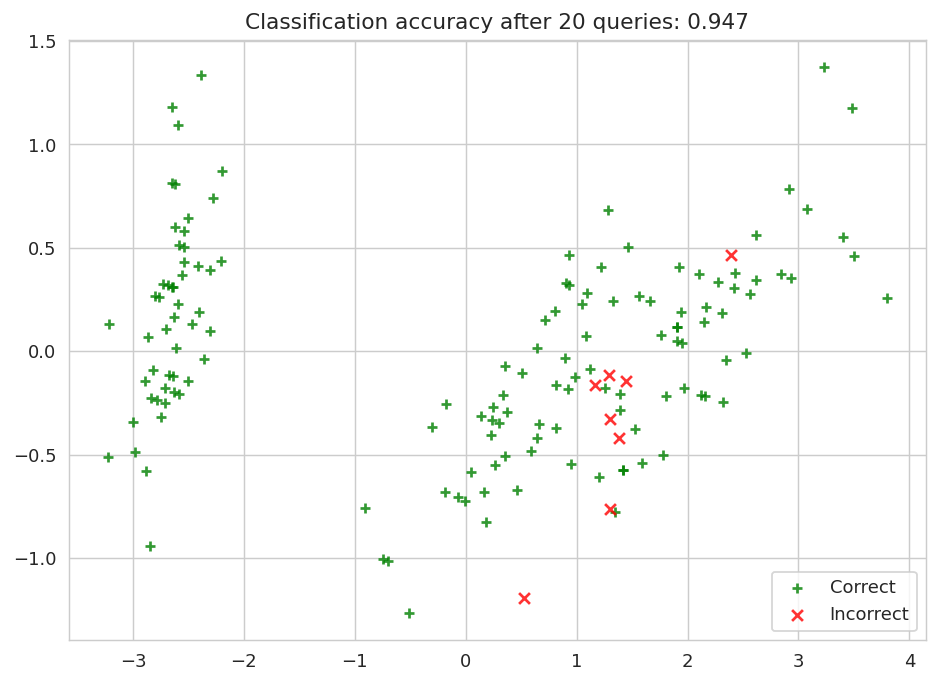

In [105]:
# Isolate the data we'll need for plotting.
predictions = learner.predict(X_raw)
is_correct = (predictions == y_raw)

# Plot our updated classification results once we've trained our learner.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.scatter(x=x_component[is_correct],  y=y_component[is_correct],  c='g', marker='+', label='Correct',   alpha=8/10)
ax.scatter(x=x_component[~is_correct], y=y_component[~is_correct], c='r', marker='x', label='Incorrect', alpha=8/10)

ax.set_title('Classification accuracy after {n} queries: {final_acc:.3f}'.format(n=N_QUERIES, final_acc=performance_history[-1]))
ax.legend(loc='lower right')

plt.show()

#Szwabe: Proper evaluation: on the pool excluding the teaching pool (Please comment on the differences)

In [106]:
learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

In [107]:
print("X_train type: ", type(X_train))
print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)

X_train type:  <class 'numpy.ndarray'>
X_train shape:  (3, 4)
y_train shape:  (3,)


In [108]:
import copy

In [109]:
X_pool = copy.deepcopy(X_raw)
y_pool = copy.deepcopy(y_raw)

In [110]:
#unqueried_score = learner.score(X_raw, y_raw)
unqueried_score = learner.score(X_pool, y_pool)

In [111]:
N_QUERIES = 20
performance_history = [unqueried_score]

# Allow our model to query our unlabeled dataset for the most
# informative points according to our query strategy (uncertainty sampling).
for index in range(N_QUERIES):
  query_index, query_instance = learner.query(X_pool)

  # Teach our ActiveLearner model the record it has requested.
  X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
  print("X type: ", type(X))
  print("X shape: ", X.shape)
  print("y shape: ", y.shape)
  learner.teach(X=X, y=y)

  learner_X_training = learner.X_training
  print("learner_X_training type: ", type(learner_X_training))
  print("learner_X_training shape: ", learner_X_training.shape)
  print("learner_X_training shape: ", learner_X_training.shape)


  # Remove the queried instance from the unlabeled pool.
  X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
  print("X_pool type: ", type(X_pool))
  print("X_pool shape: ", X_pool.shape)
  print("y_pool shape: ", y_pool.shape)

  # Calculate and report our model's accuracy.
  model_accuracy = learner.score(X_pool, y_pool)
  print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))

  # Save our model's performance for plotting.
  performance_history.append(model_accuracy)


X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (149, 4)
y_pool shape:  (149,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (148, 4)
y_pool shape:  (148,)
Accuracy after query 2: 0.6622
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 3: 0.8912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

**Answer**: If we evaluate our model on all examples (predicted and known ones), we will artificially exaggerate accuracy of the model. If we will use only examples that are predicted in each iteration (excluding known ones), we will get pure accuracy of the model.

## Evaluate our model's performance

Here, we first plot the query iteration index against model accuracy. To visualize the performance of our classifier, we also plot the correct and incorrect predictions on the full dataset.

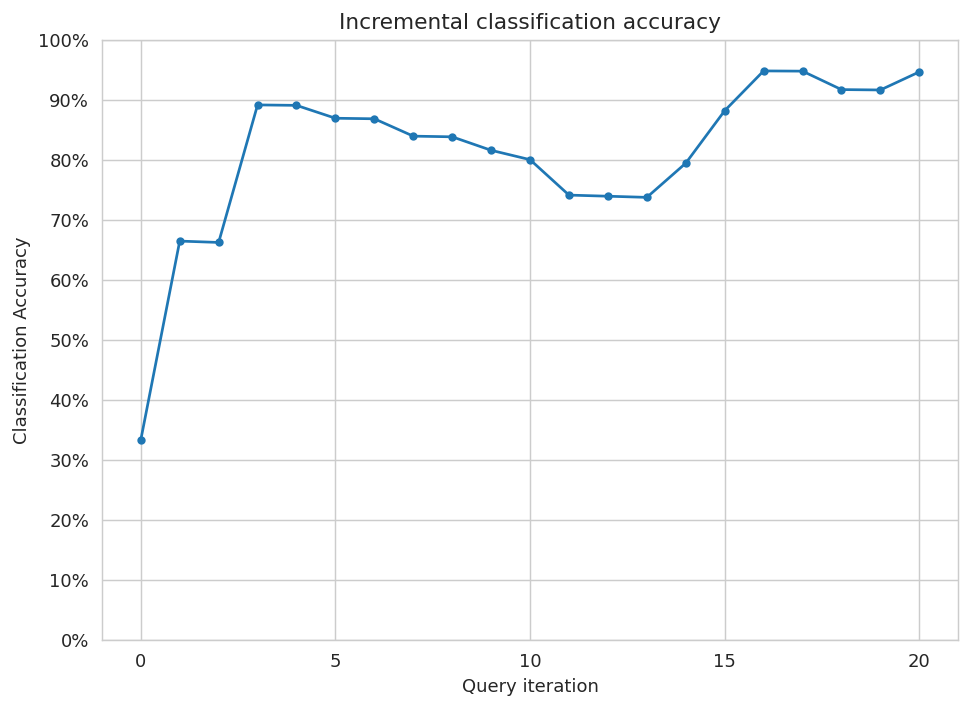

In [112]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.plot(performance_history)
ax.scatter(range(len(performance_history)), performance_history, s=13)

ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')

plt.show()

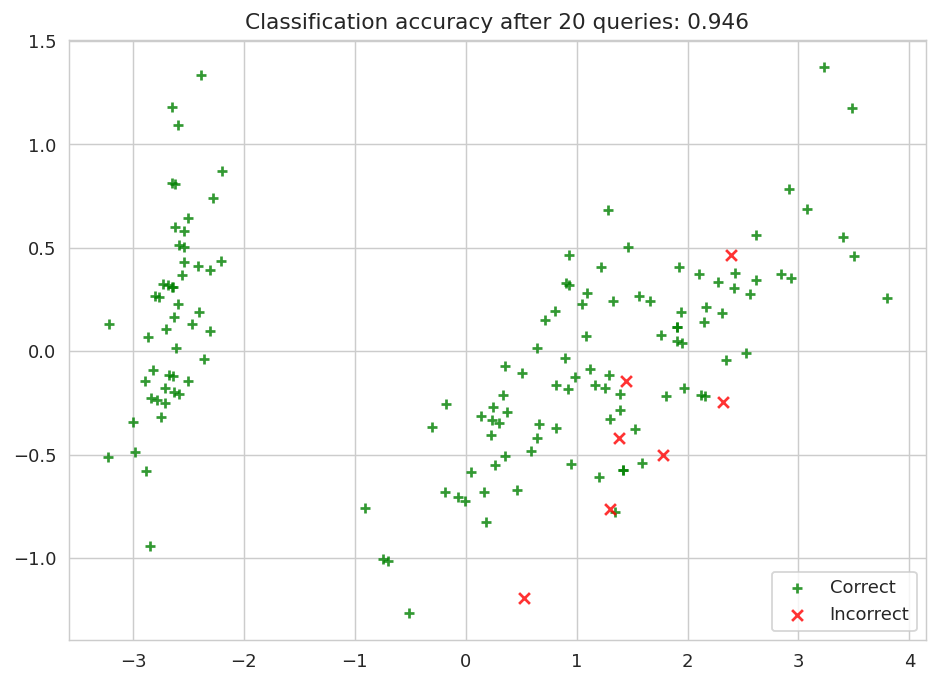

In [113]:
# Isolate the data we'll need for plotting.
predictions = learner.predict(X_raw)
is_correct = (predictions == y_raw)

# Plot our updated classification results once we've trained our learner.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.scatter(x=x_component[is_correct],  y=y_component[is_correct],  c='g', marker='+', label='Correct',   alpha=8/10)
ax.scatter(x=x_component[~is_correct], y=y_component[~is_correct], c='r', marker='x', label='Incorrect', alpha=8/10)

ax.set_title('Classification accuracy after {n} queries: {final_acc:.3f}'.format(n=N_QUERIES, final_acc=performance_history[-1]))
ax.legend(loc='lower right')

plt.show()

#Szwabe: Even more proper evaluation: on the pool excluding the teaching pool with prior raw data shuffling (Please comment on the differences)

In [114]:
np.random.seed(RANDOM_STATE_SEED)
np.random.seed()

In [115]:
not_yet_shuffling_indices = np.arange(y_raw.shape[0])
not_yet_shuffling_indices

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149])

In [116]:
np.random.shuffle(not_yet_shuffling_indices)

In [117]:
shuffling_indices = not_yet_shuffling_indices
shuffling_indices

array([133, 113,  27,  95, 142,  37,  56,  64, 130, 102,  81, 135, 115,
        38,  93,  92,  96, 143, 121,  68,  87,  44,  78, 129,  65, 140,
       106, 109,  40,   5,  86,  97,  72,  29, 112, 127,  26,  28, 138,
        24,  12, 139,  98,  16, 131, 117, 147,  33,  48,  94,  61,  47,
        75, 103,  99, 125, 141,  42,  22,  34, 114,  10,  11, 124, 101,
        57,  45,   7, 149,  71, 126,  50, 111,   4,  91,  17, 122,  13,
        67,  46,  32,  30,  79,   1,  43,  59,  73,   3,  21,   9,   0,
       134,  62,  18,  35, 145,   8,  53, 144, 146,  74,  52,  83, 136,
       123,  84, 118,   2,  90, 105, 120, 128,  58, 132, 104,  36,  49,
        39, 107,  15,  25,  20,   6,  70,  23,  80,  51,  55,  19,  88,
       108, 148, 110,  89,  85,  41, 116, 100,  60,  69,  54,  76, 137,
        82, 119,  66,  14,  77,  31,  63])

In [118]:
X_raw = X_raw[shuffling_indices]
y_raw = y_raw[shuffling_indices]

In [119]:
# Isolate our examples for our labeled dataset.
#n_labeled_examples = X_raw.shape[0]

#training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

X_train = X_raw[training_indices]
y_train = y_raw[training_indices]

# Isolate the non-training examples we'll be querying.
X_pool = np.delete(X_raw, training_indices, axis=0)
y_pool = np.delete(y_raw, training_indices, axis=0)

In [120]:
#from sklearn.neighbors import KNeighborsClassifier
#from modAL.models import ActiveLearner

# Specify our core estimator along with it's active learning model.
knn = KNeighborsClassifier(n_neighbors=3)
#learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

In [121]:
learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

In [122]:
print("X_train type: ", type(X_train))
print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)

X_train type:  <class 'numpy.ndarray'>
X_train shape:  (3, 4)
y_train shape:  (3,)


In [123]:
#N_QUERIES = 20
N_QUERIES = 50
performance_history = [unqueried_score]

# Allow our model to query our unlabeled dataset for the most
# informative points according to our query strategy (uncertainty sampling).
for index in range(N_QUERIES):
  query_index, query_instance = learner.query(X_pool)

  # Teach our ActiveLearner model the record it has requested.
  X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
  print("X type: ", type(X))
  print("X shape: ", X.shape)
  print("y shape: ", y.shape)
  learner.teach(X=X, y=y)

  learner_X_training = learner.X_training
  print("learner_X_training type: ", type(learner_X_training))
  print("learner_X_training shape: ", learner_X_training.shape)
  print("learner_X_training shape: ", learner_X_training.shape)

  # Remove the queried instance from the unlabeled pool.
  X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
  print("X_pool type: ", type(X_pool))
  print("X_pool shape: ", X_pool.shape)
  print("y_pool shape: ", y_pool.shape)

  # Calculate and report our model's accuracy.
  model_accuracy = learner.score(X_pool, y_pool)
  print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))

  # Save our model's performance for plotting.
  performance_history.append(model_accuracy)

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9306
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (24, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (44, 4)
learner_X_training shape:  (44, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (106, 4)
y_pool shape:  (106,)
Accuracy after query 41: 0.9906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (45, 4)
learner_X_training shape:  (45, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (105, 4)
y_pool shape:  (105,)
Accuracy after query 42: 0.9905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (46, 4)
learner_X_training shape:  (46, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (104, 4)
y_pool shape:  (104,)
Accuracy after query 43: 0.9904
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

**Answer**: In this case we also exclude points that are used for training from calculating accuracy, but this time we give our learner points that are the most informative for it, so the learning is most effective. Additionally, we shuffle the data which lets us believe model will rely purely on learning not the position of the object on the training set (we have to remember that iris dataset is sorted by class).

## Evaluate our model's performance

Here, we first plot the query iteration index against model accuracy. To visualize the performance of our classifier, we also plot the correct and incorrect predictions on the full dataset.

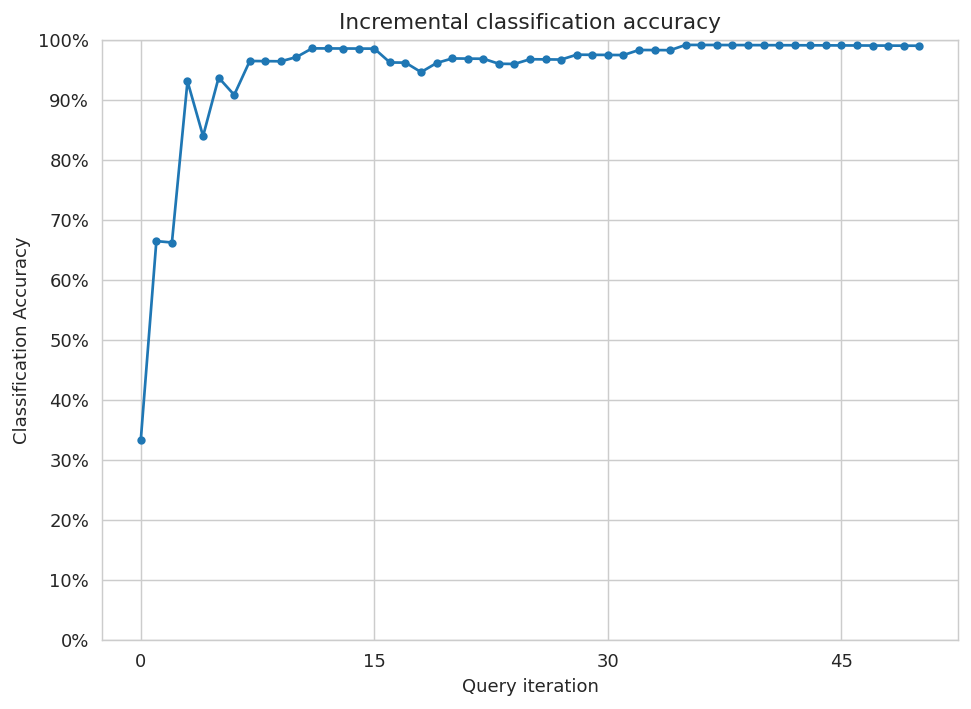

In [124]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.plot(performance_history)
ax.scatter(range(len(performance_history)), performance_history, s=13)

ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')

plt.show()

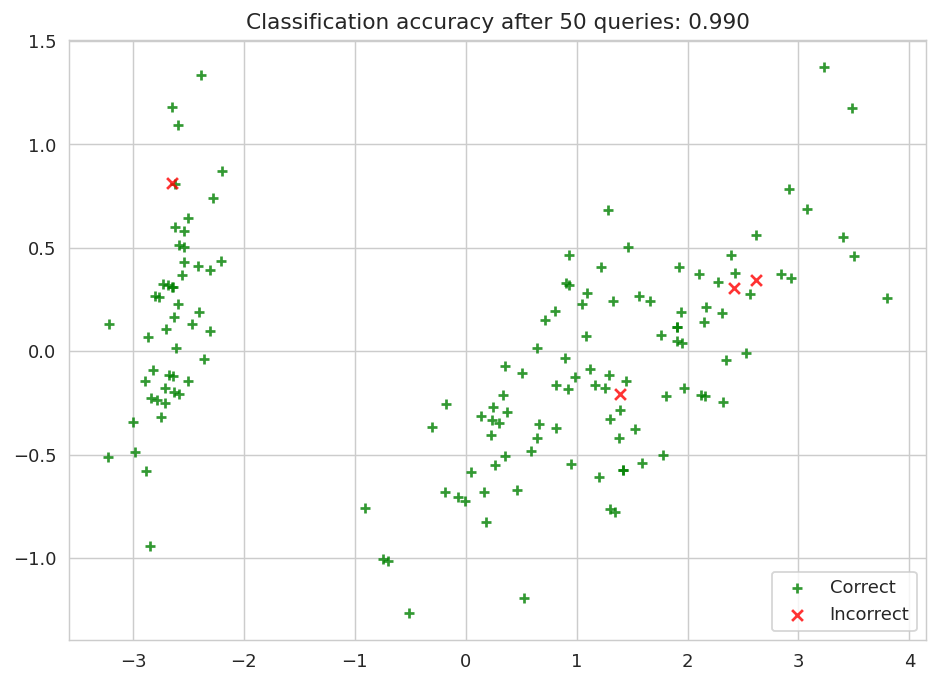

In [125]:
# Isolate the data we'll need for plotting.
predictions = learner.predict(X_raw)
is_correct = (predictions == y_raw)

# Plot our updated classification results once we've trained our learner.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.scatter(x=x_component[is_correct],  y=y_component[is_correct],  c='g', marker='+', label='Correct',   alpha=8/10)
ax.scatter(x=x_component[~is_correct], y=y_component[~is_correct], c='r', marker='x', label='Incorrect', alpha=8/10)

ax.set_title('Classification accuracy after {n} queries: {final_acc:.3f}'.format(n=N_QUERIES, final_acc=performance_history[-1]))
ax.legend(loc='lower right')

plt.show()

Uncertainty sampling
==================

When you present unlabelled examples to an active learner, it finds you the most *useful* example and presents it for you to be labelled. This is done by first calculating the *usefulness* of prediction (whatever it means) for each example and select an instance based on the usefulness. The thing is, there are several ways to measure this. They are based upon the classification uncertainty, hence they are called *uncertainty measures*. In modAL, currently you can select from three built-in measures: *classification uncertainty*, *classification margin* and *classification entropy*. In this quick tutorial, we are going to review them. For more details, see Section 2.3 of the awesome book [Active learning by Burr Settles](http://active-learning.net/)!

In [126]:
import numpy as np

Classification uncertainty
-------------------------------------

The simplest measure is the uncertainty of classification defined by

$$U(x)=1-P(\hat{x}|x)$$

where $x$ is the instance to be predicted and $\hat{x}$ is the most likely prediction.

For example, if you have classes ``[0, 1, 2]`` and classification probabilities ``[0.1, 0.2, 0.7]``, the most likely class according to the classifier is ``2`` with uncertainty 0.3. If you have three instances with class probabilities

In [127]:
proba = np.array([[0.1 , 0.85, 0.05],
                  [0.6 , 0.3 , 0.1 ],
                  [0.39, 0.61, 0.0 ]])

the corresponding uncertainties are:

In [128]:
1 - proba.max(axis=1)

array([0.15, 0.4 , 0.39])

In the above example, the most uncertain sample is the second one. When
querying for labels based on this measure, the strategy selects the
sample with the highest uncertainty.

For this ternary classification problem, given the first two
probabilities, the classification uncertainty looks like the following.

In [129]:
import matplotlib.pyplot as plt
%matplotlib inline

from itertools import product
n_res = 100
p1, p2 = np.meshgrid(np.linspace(0, 1, n_res), np.linspace(0, 1, n_res))
p3 = np.maximum(1 - p1 - p2, 0)

In [130]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")

In [131]:
plt.style.available

['Solarize_Light2',
 '_classic_test_patch',
 '_mpl-gallery',
 '_mpl-gallery-nogrid',
 'bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'petroff10',
 'seaborn-v0_8',
 'seaborn-v0_8-bright',
 'seaborn-v0_8-colorblind',
 'seaborn-v0_8-dark',
 'seaborn-v0_8-dark-palette',
 'seaborn-v0_8-darkgrid',
 'seaborn-v0_8-deep',
 'seaborn-v0_8-muted',
 'seaborn-v0_8-notebook',
 'seaborn-v0_8-paper',
 'seaborn-v0_8-pastel',
 'seaborn-v0_8-poster',
 'seaborn-v0_8-talk',
 'seaborn-v0_8-ticks',
 'seaborn-v0_8-white',
 'seaborn-v0_8-whitegrid',
 'tableau-colorblind10']

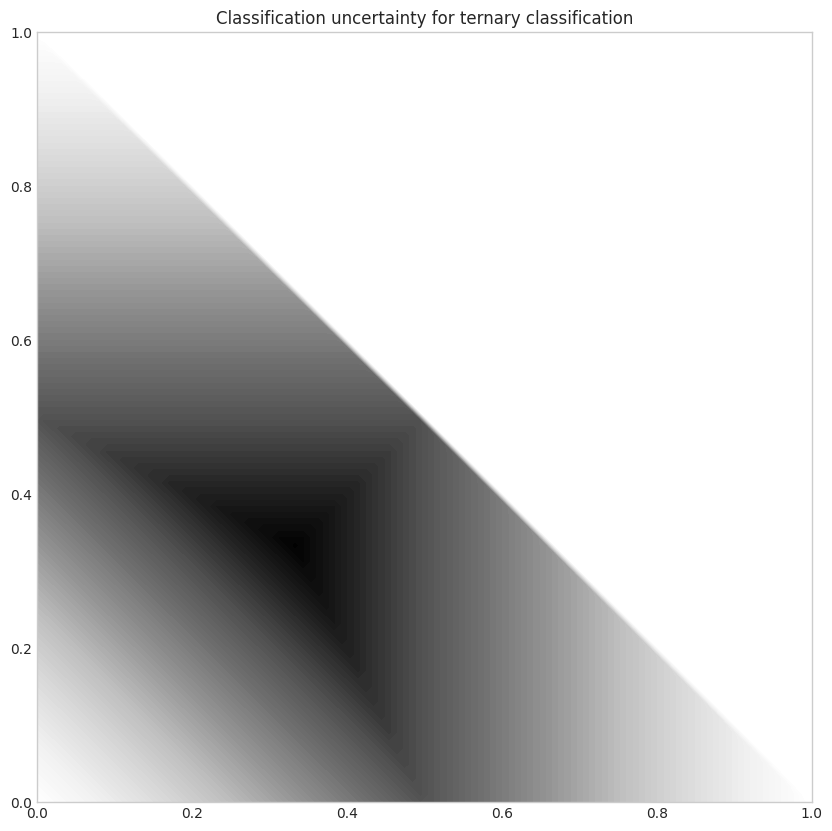

In [132]:
uncertainty = 1 - np.maximum.reduce([p1, p2, p3])

with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(10, 10))
    plt.contourf(p1, p2, uncertainty*((p1+p2) < 1), 100)
    plt.title('Classification uncertainty for ternary classification')

## Szwabe: What about a 2-class case? (Please comment on the differences)

**Answer**: For 2-class problem we would have straight line (instead of triangle) with color signaling value. If we wish, we can plot it on Cartesian system, then x axis is probability of the class a (probability of class b is 1-P(a)) and value for x is the uncertainity. Additionally, the lower the uncertainity, the more sure we are that class with highest probability is true.

In [133]:
p1.shape

(100, 100)

In [134]:
for p1_slice_idx in range(p1.shape[0]):
  p1_slice = p1[p1_slice_idx, :]


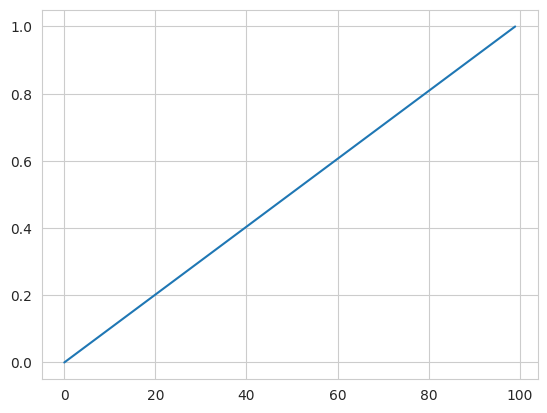

In [135]:
plt.plot(p1_slice)

In [136]:
p2_slice = 1 - p1_slice

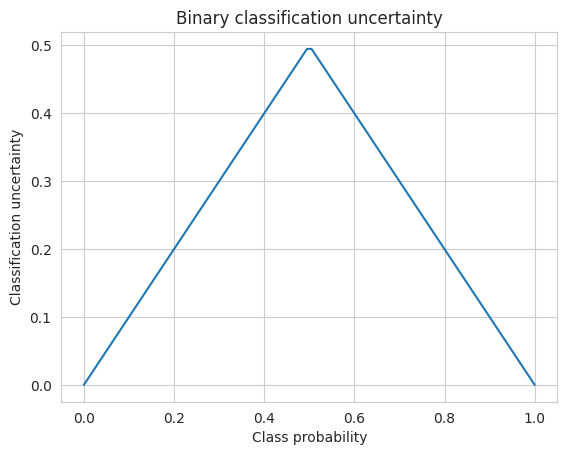

In [137]:
uncertainty_slice = 1 - np.maximum.reduce([p1_slice, p2_slice])
plt.plot(p1_slice, uncertainty_slice)
plt.title('Binary classification uncertainty')
plt.xlabel('Class probability')
plt.ylabel('Classification uncertainty')
plt.show()

In [138]:
p1[-1, :] == p1_slice

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

In [139]:
p1[-1, :] == p1[-2, :]

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

In [140]:
uncertainty.shape

(100, 100)

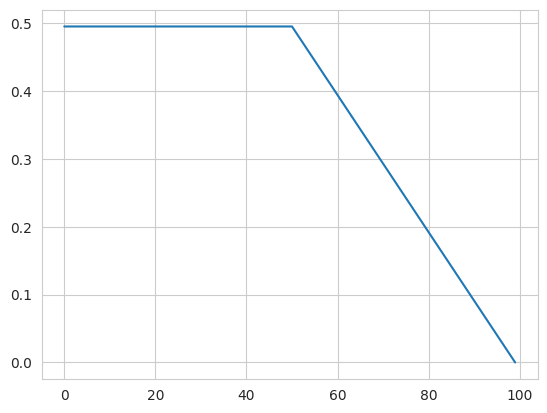

In [141]:
plt.plot(uncertainty[:,50])
plt.show()

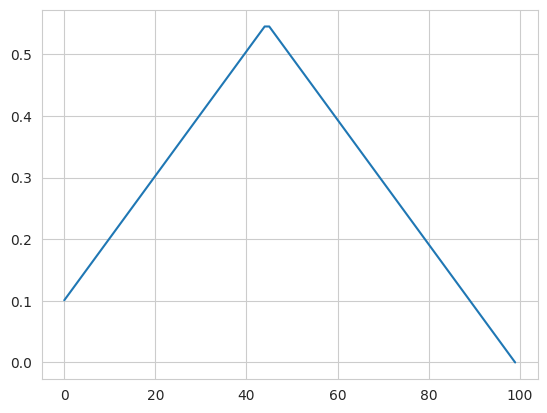

In [142]:
plt.plot(uncertainty[:,10])
plt.show()

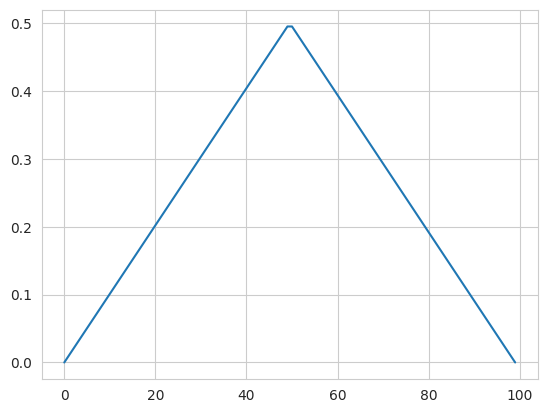

In [143]:
plt.plot(uncertainty[:,0])
plt.show()

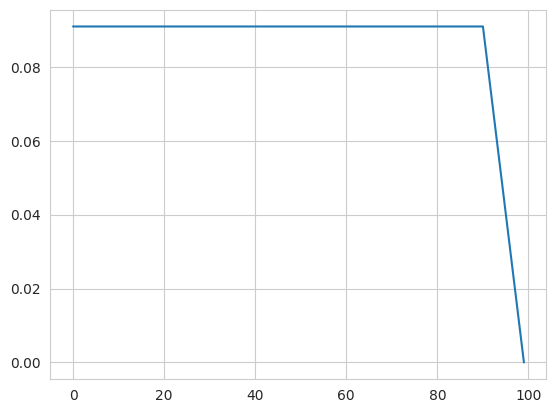

In [144]:
plt.plot(uncertainty[:,90])
plt.show()

Classification margin
-------------------------------

Classification margin is the difference in probability of the first and second most likely prediction, that is, it is defined by

$$M(x)=P(\hat{x_1}|x)-P(\hat{x_2}|x)$$

where $\hat{x_1}$ and $\hat{x_2}$ are the first and second most likely classes. Using the same example we used for classification uncertainty, if the class probabilities are

In [145]:
proba = np.array([[0.1 , 0.85, 0.05],
                  [0.6 , 0.3 , 0.1 ],
                  [0.39, 0.61, 0.0 ]])

the corresponding margins are:

In [146]:
part = np.partition(-proba, 1, axis=1)
margin = - part[:, 0] + part[:, 1]

In [147]:
margin

array([0.75, 0.3 , 0.22])

When querying for labels, the strategy selects the sample with the *smallest* margin, since the smaller the decision margin is, the more unsure the decision. In this case, it would be the third sample. For this ternary classification problem, the classifier margin plotted against the first two probabilities are the following.

In [148]:
proba = np.vstack((p1.ravel(), p2.ravel(), p3.ravel())).T

part = np.partition(-proba, 1, axis=1)
margin = - part[:, 0] + part[:, 1]

margin = margin.reshape(p1.shape)

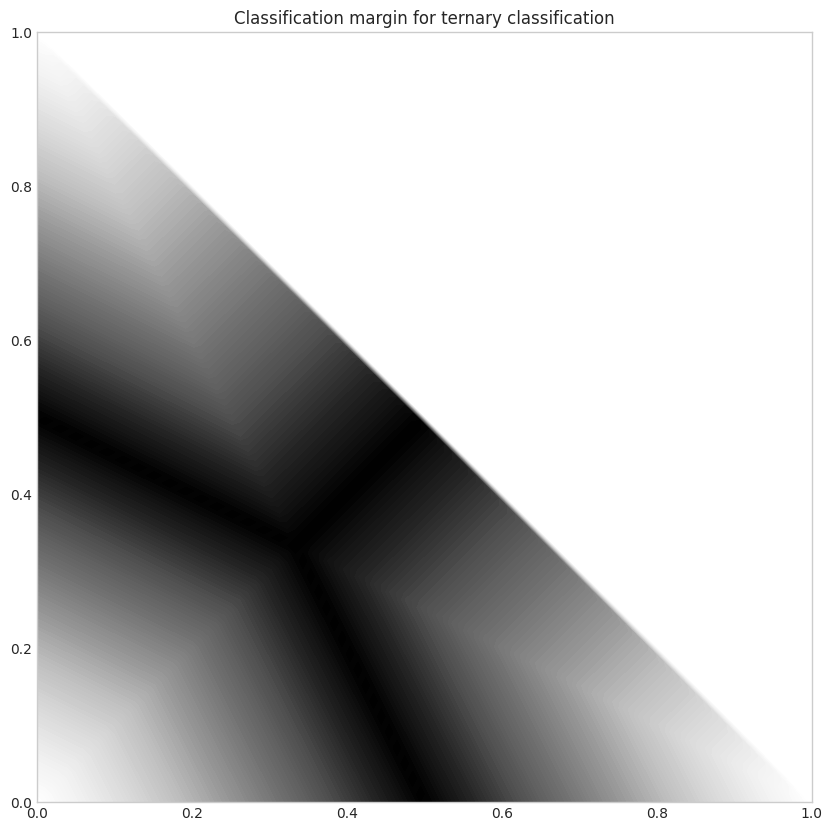

In [149]:
with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(10, 10))
    plt.contourf(p1, p2, (1-margin)*((p1+p2) < 1), 100)
    plt.title('Classification margin for ternary classification')

## Szwabe: What about a 2-class case? (Please comment on the differences)

**Answer**: For 2-class problem we would have straight line (instead of triangle) with color signaling value. If we wish we can plot it on Cartesian system, then x axis is probability of the class a (probability of class b is 1-P(a)) and value for x is the margin. Additionally, the higher the margin, the more sure we are that class with highest probability is true.

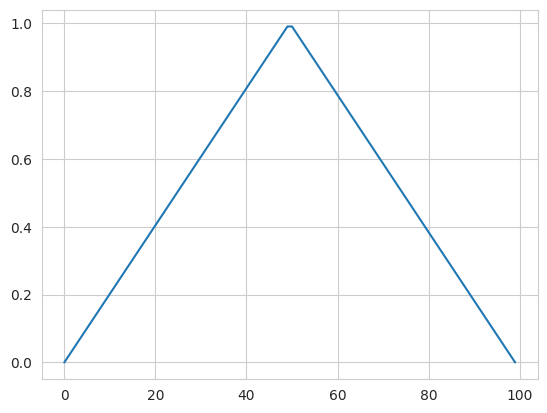

In [150]:
plt.plot((1-margin)[:,0])
plt.show()

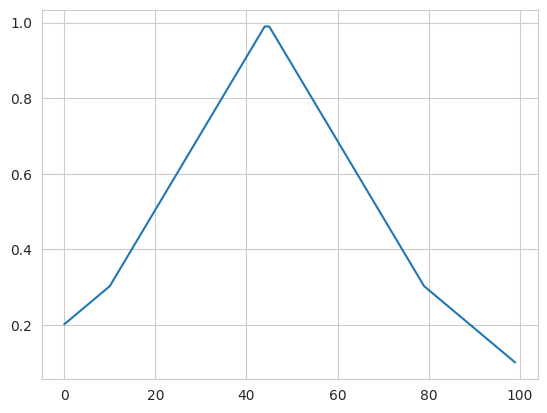

In [151]:
plt.plot((1-margin)[:,10])
plt.show()

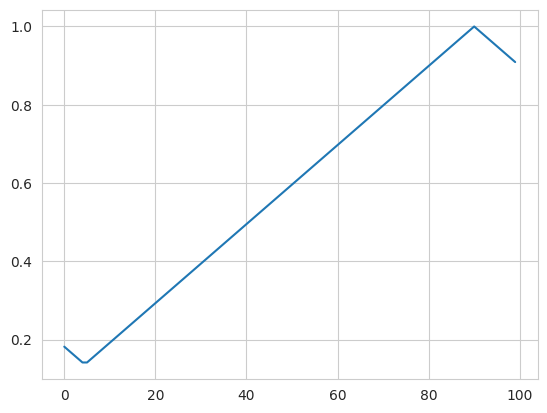

In [152]:
plt.plot((1-margin)[:,90])
plt.show()

Classification entropy
--------------------------------

The third built-in uncertainty measure is the classification entropy, which is defined by

$$H(x)=-\sum_{k}p_k\log(p_k)$$

where $p_k$ is the probability of the sample belonging to the $k$-th class. Heuristically, the entropy is proportional to the average number of guesses one has to make to find the true class. In our usual example

In [153]:
proba = np.array([[0.1 , 0.85, 0.05],
                  [0.6 , 0.3 , 0.1 ],
                  [0.39, 0.61, 0.0 ]])

the corresponding entropies are

In [154]:
from scipy.stats import entropy

entropy(proba.T)

array([0.51818621, 0.89794572, 0.66874809])

The closer the distribution to uniform, the larger the entropy. Again, if we plot the entropy against the first two probabilities of a ternary classification problem, we obtain the following.

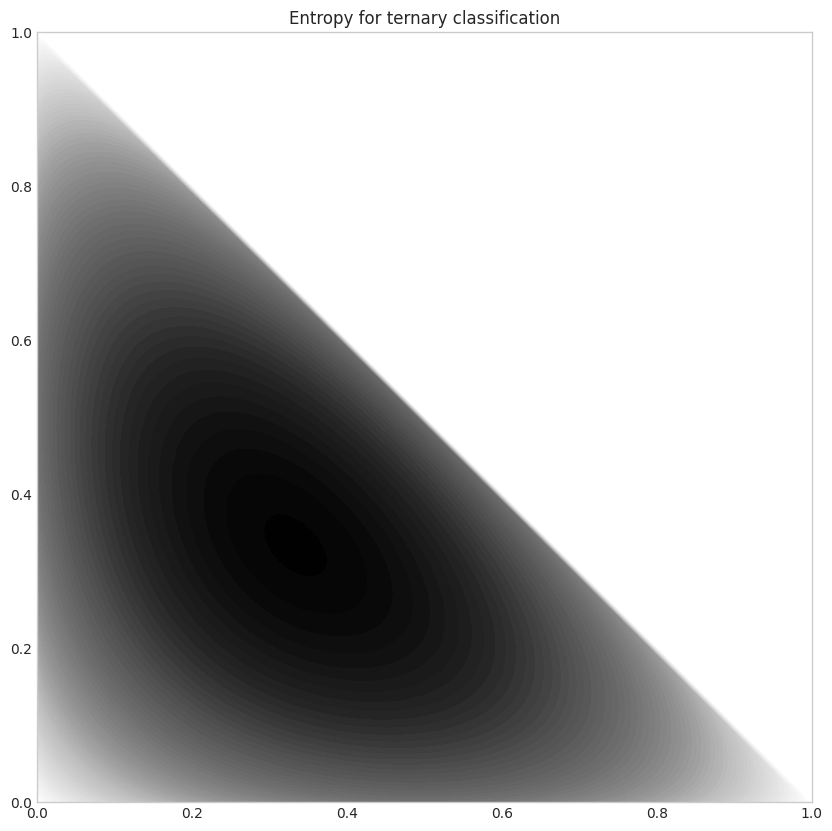

In [155]:
proba = np.vstack((p1.ravel(), p2.ravel(), p3.ravel())).T
entr = entropy(proba.T).reshape(p1.shape)

with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(10, 10))
    plt.contourf(p1, p2, entr*((p1+p2) < 1), 100)
    plt.title('Entropy for ternary classification')

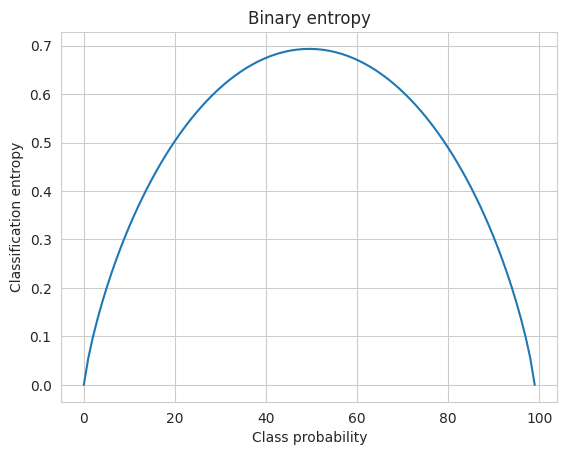

In [156]:
plt.plot(entr[:,0])
plt.title('Binary entropy')
plt.xlabel('Class probability')
plt.ylabel('Classification entropy')
plt.show()

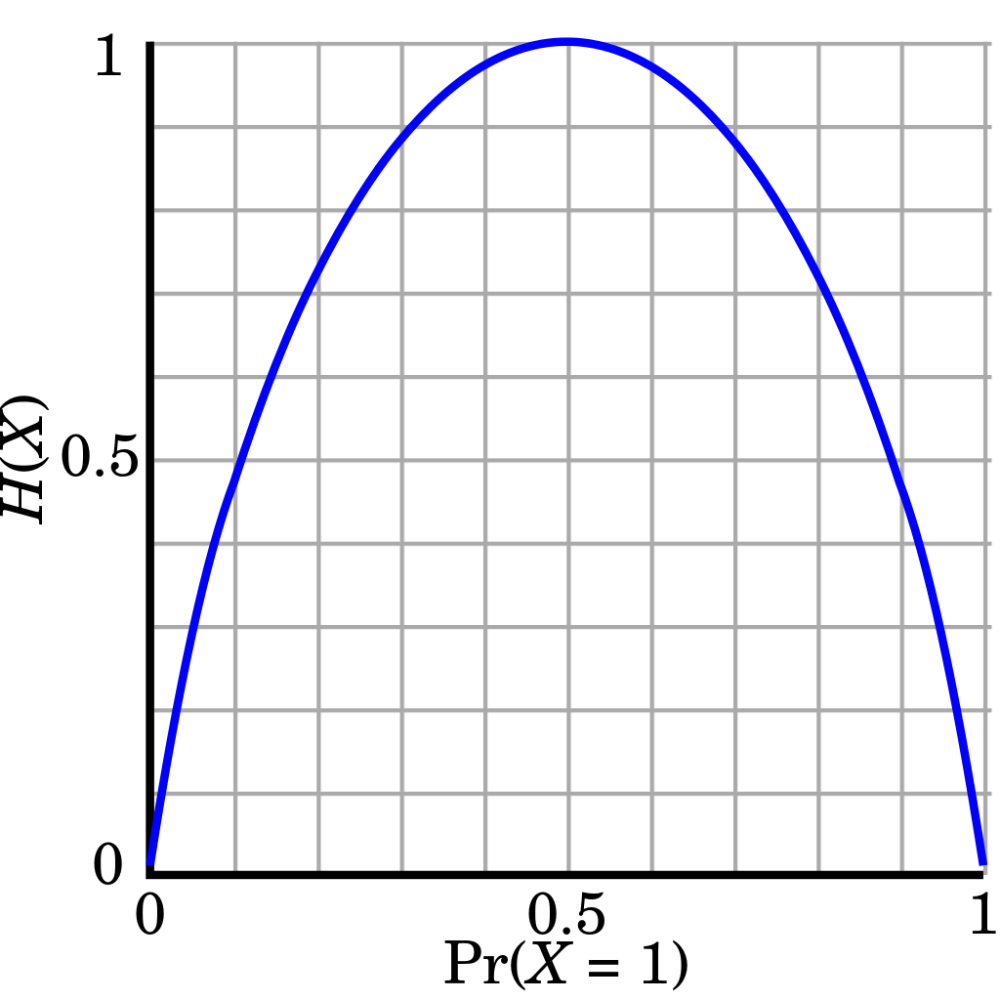

Entropy of a Bernoulli trial as a function of binary outcome probability, called the binary entropy function.

[https://en.wikipedia.org/wiki/Binary_entropy_function]

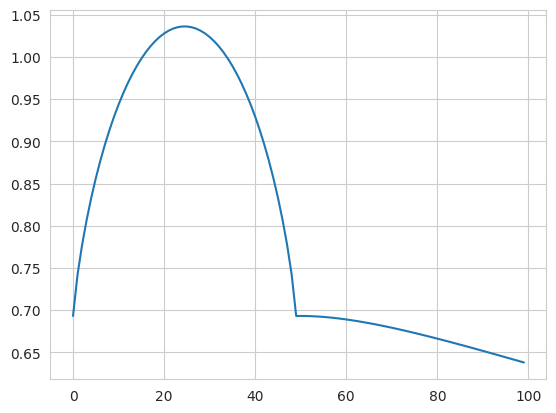

In [157]:
plt.plot(entr[:,50])
plt.show()

## Szwabe: What about a 2-class case? (Please comment on the differences)

**Answer**: For 2-class problem we would have straight line (instead of triangle) with color signaling value. If we wish we can plot it on Cartesian system, then x axis is probability of the class a (probability of class b is 1-P(a)) and value for x is the uncertainity. Additionally, the higher entropy, the higher the chaos and less sure we are that class with highest probability is true.

Query by committee
=================

*Query by committee* is another popular active learning strategy, which alleviates many disadvantages of uncertainty sampling. For instance, uncertainty sampling tends to be biased towards the actual learner and it may miss important examples which are not in the sight of the estimator. This is fixed by keeping several hypotheses at the same time, selecting queries where disagreement occurs between them. In this example, we shall see how this works in the simplest case, using the iris dataset.

The executable script for this example is [available here](https://github.com/cosmic-cortex/modAL/blob/master/examples/query_by_committee.py)!

To enforce a reproducible result across runs, we set a random seed.

In [158]:
import numpy as np

# Set our RNG seed for reproducibility.
RANDOM_STATE_SEED = 1
np.random.seed(RANDOM_STATE_SEED)

The dataset
-----------------

We are going to use the iris dataset for this example. For more information on the iris dataset, see [its wikipedia page](https://en.wikipedia.org/wiki/Iris_flower_data_set). For its scikit-learn interface, see [the scikit-learn documentation](http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_iris.html).

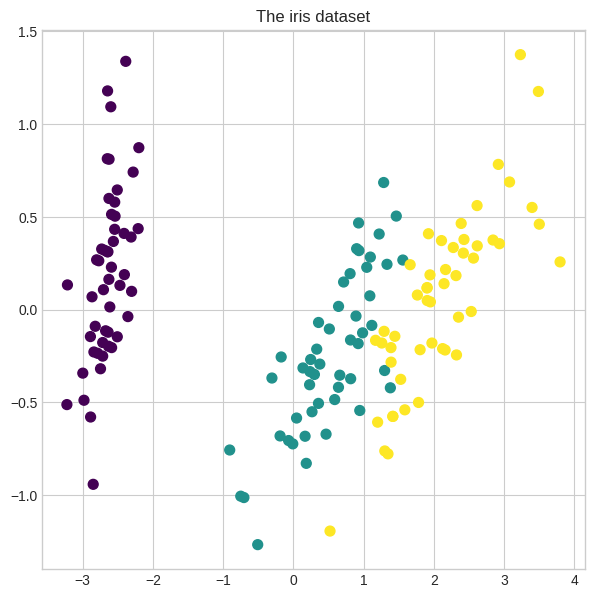

In [159]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.decomposition import PCA
from sklearn.datasets import load_iris

# loading the iris dataset
iris = load_iris()

# visualizing the classes
with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(7, 7))
    pca = PCA(n_components=2).fit_transform(iris['data'])
    plt.scatter(x=pca[:, 0], y=pca[:, 1], c=iris['target'], cmap='viridis', s=50)
    plt.title('The iris dataset')
    plt.show()


In [160]:
print(iris["DESCR"])

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

Initializing the Committee
--------------------------

In this example, we are going to use the ``Committee`` class from ``modAL.models``. Its interface is almost exactly identical to the
``ActiveLearner``. Upon initialization, ``Committee`` requires a list of active learners. First, we generate the pool of unlabeled data.

In [161]:
from copy import deepcopy

# generate the pool
X_pool = deepcopy(iris['data'])
y_pool = deepcopy(iris['target'])

Now we are ready to initialize the ```Committee```. For this, we need a list of ```ActiveLearner``` objects, which we will define now.

In [162]:
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from modAL.models import ActiveLearner, Committee

# initializing Committee members
n_members = 2
learner_list = list()

for member_idx in range(n_members):
    # initial training data
    n_initial = 2
    train_idx = np.random.choice(range(X_pool.shape[0]), size=n_initial, replace=False)
    X_train = X_pool[train_idx]
    y_train = y_pool[train_idx]

    # creating a reduced copy of the data with the known instances removed
    X_pool = np.delete(X_pool, train_idx, axis=0)
    y_pool = np.delete(y_pool, train_idx)

    # initializing learner
    learner = ActiveLearner(
        estimator=RandomForestClassifier(),
        X_training=X_train, y_training=y_train
    )
    learner_list.append(learner)

# assembling the committee
committee = Committee(learner_list=learner_list)

As you can see, the various hypotheses (which are taking the form of ActiveLearners) can be quite different.

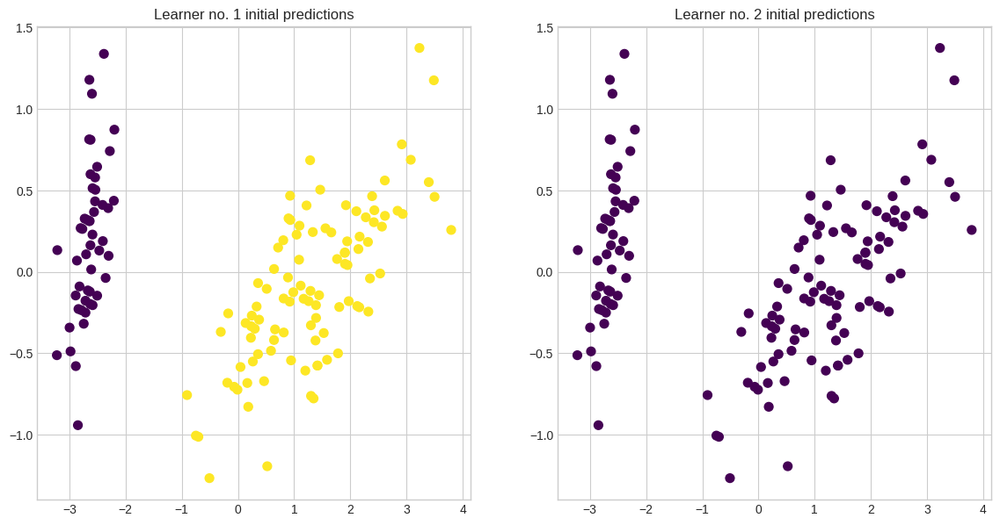

In [163]:
with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(n_members*7, 7))
    for learner_idx, learner in enumerate(committee):
        plt.subplot(1, n_members, learner_idx + 1)
        plt.scatter(x=pca[:, 0], y=pca[:, 1], c=learner.predict(iris['data']), cmap='viridis', s=50)
        plt.title('Learner no. %d initial predictions' % (learner_idx + 1))
    plt.show()

Prediction is done by averaging the class probabilities for each learner and chosing the most likely class.

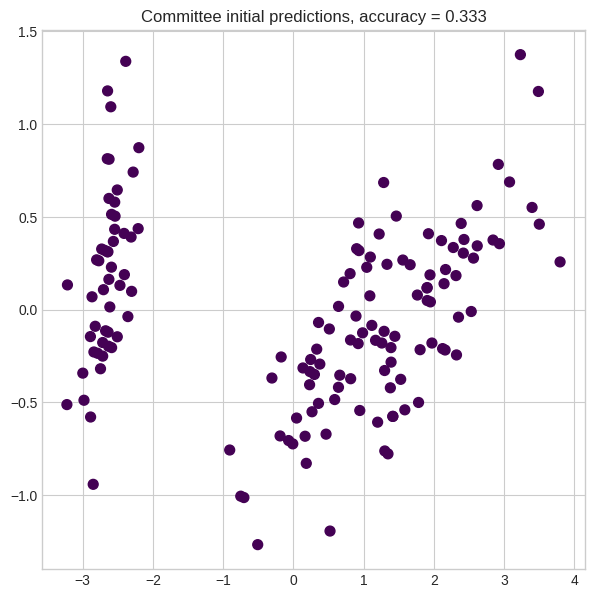

In [164]:
unqueried_score = committee.score(iris['data'], iris['target'])

with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(7, 7))
    prediction = committee.predict(iris['data'])
    plt.scatter(x=pca[:, 0], y=pca[:, 1], c=prediction, cmap='viridis', s=50)
    plt.title('Committee initial predictions, accuracy = %1.3f' % unqueried_score)
    plt.show()

Active learning
----------------------

The active learning loop is the same as for the ``ActiveLearner``.

In [165]:
performance_history = [unqueried_score]

# query by committee
n_queries = 20
for idx in range(n_queries):
    query_idx, query_instance = committee.query(X_pool)
    committee.teach(
        X=X_pool[query_idx].reshape(1, -1),
        y=y_pool[query_idx].reshape(1, )
    )
    performance_history.append(committee.score(iris['data'], iris['target']))
    # remove queried instance from pool
    X_pool = np.delete(X_pool, query_idx, axis=0)
    y_pool = np.delete(y_pool, query_idx)

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

After a few queries, the hypotheses straighten out their disagreements and they reach consensus. Prediction accuracy is greatly improved in this case.

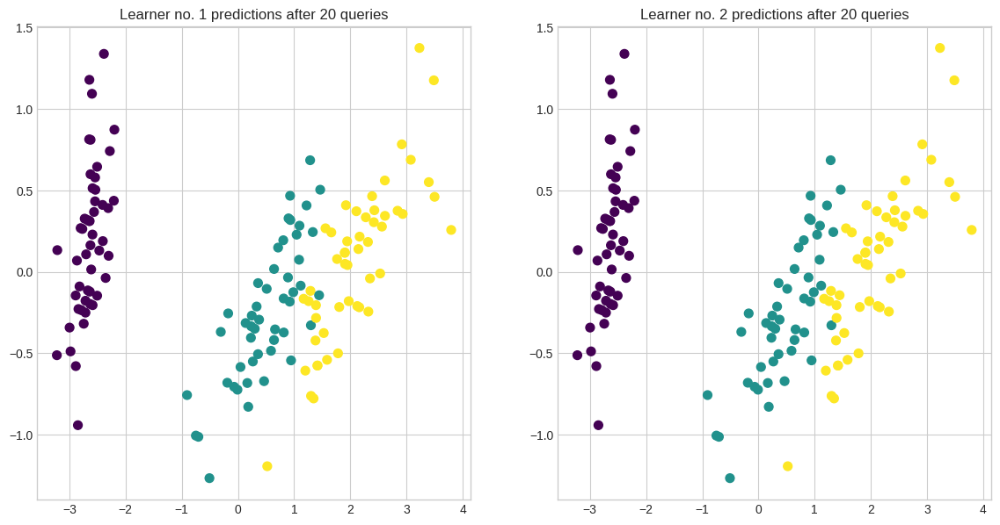

In [166]:
# visualizing the final predictions per learner
with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(n_members*7, 7))
    for learner_idx, learner in enumerate(committee):
        plt.subplot(1, n_members, learner_idx + 1)
        plt.scatter(x=pca[:, 0], y=pca[:, 1], c=learner.predict(iris['data']), cmap='viridis', s=50)
        plt.title('Learner no. %d predictions after %d queries' % (learner_idx + 1, n_queries))
    plt.show()

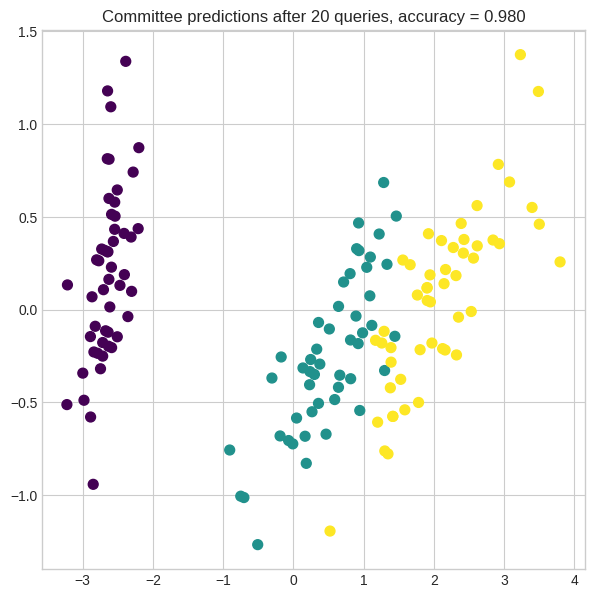

In [167]:
# visualizing the Committee's predictions
with plt.style.context('seaborn-v0_8-whitegrid'):
    plt.figure(figsize=(7, 7))
    prediction = committee.predict(iris['data'])
    plt.scatter(x=pca[:, 0], y=pca[:, 1], c=prediction, cmap='viridis', s=50)
    plt.title('Committee predictions after %d queries, accuracy = %1.3f'
              % (n_queries, committee.score(iris['data'], iris['target'])))
    plt.show()

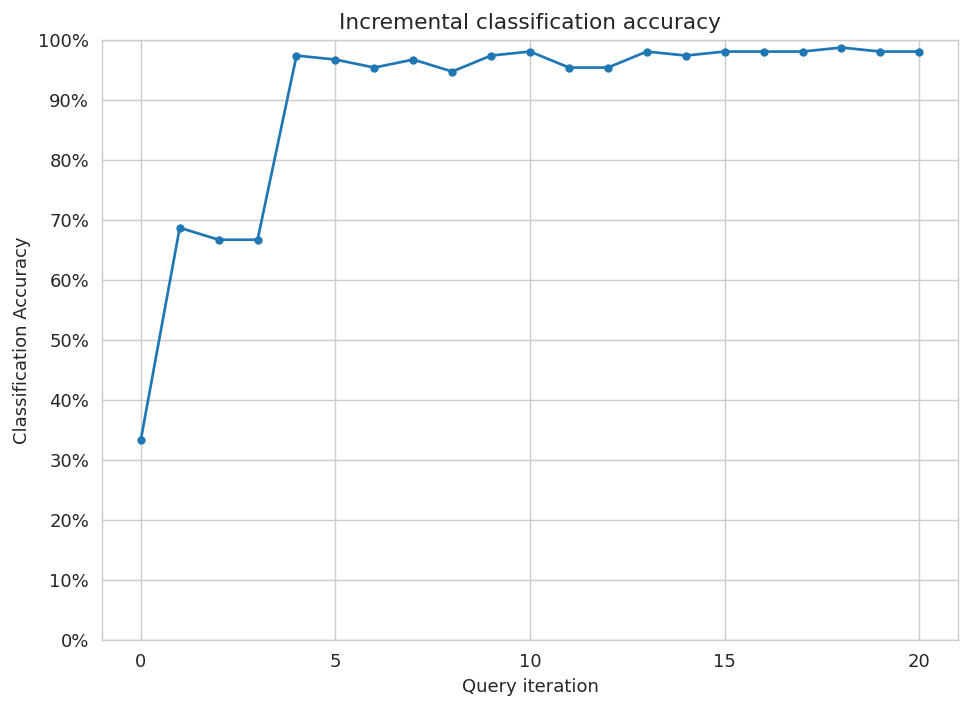

In [168]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.plot(performance_history)
ax.scatter(range(len(performance_history)), performance_history, s=13)

ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')

plt.show()

## Szwabe: What about a 2-class case? (Please comment on the differences)

**Answer**: For two class example we would have line instead of triangle (each end of the line would be a class). Color of the line would indicate the value of the query strategy. Lines would have different shapes, but the highest values would be achieved for values in the middle (in all cases: least confident, margin, entropy). If we would like, we could plot the values on 2D space, where x would be probability of first class (probability of the other would be 1-P(class 1)) and y would be value of proper query strategy for corresponding x. Highest values would be achieved for probability=0.5.

#Comparison of query strategies

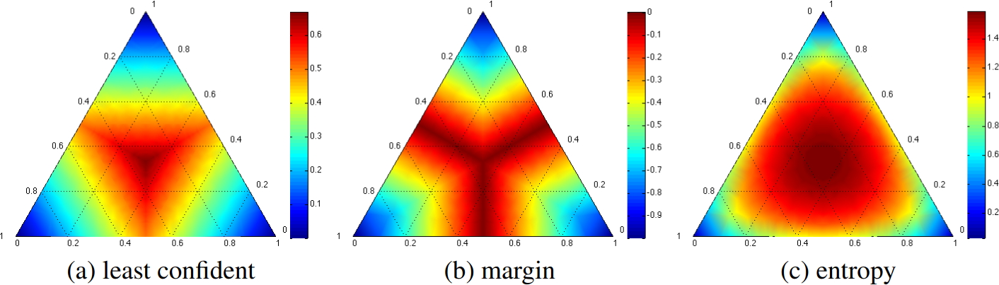

Heatmaps illustrating the query behavior of the common query strategies (aka uncertainty measures) in a three-label classification problem.
Corners indicate cases/samples where one label has very high probability, with the opposite edge showing the probability range for the other two classes when that label has very low probability.
The most informative query region for each strategy is shown in dark red, radiating from the centers. [Settles, Burr. "Active learning literature survey." (2009), https://minds.wisconsin.edu/bitstream/handle/1793/60660/TR1648.pdf]

In [169]:
from modAL.uncertainty import uncertainty_sampling, margin_sampling, entropy_sampling

In [170]:
#query_strategy=uncertainty_sampling

In [171]:
np.random.seed(RANDOM_STATE_SEED)
np.random.seed()

In [172]:
not_yet_shuffling_indices = np.arange(y_raw.shape[0])
not_yet_shuffling_indices

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149])

In [173]:
np.random.shuffle(not_yet_shuffling_indices)

In [174]:
shuffling_indices = not_yet_shuffling_indices
shuffling_indices

array([114, 136,  22, 121,  10,  59,  14, 138,  72, 143,  82,  57, 132,
        19,  84, 142,  92, 119,  99,  46,  43,   2,  27,  41,  89,  56,
        63,  68,   3,  71, 126,   5, 101,  17,  21, 123,  12,  52, 103,
        97, 100,  85,  30,  33,  48, 137, 146,  58, 124,  24, 112,  49,
        94,  11, 102,  40, 120,   9,  26,  37,  78,  44, 141, 131,  16,
       133, 144,   7,  66,  23,   1,  96,  88,  31, 134, 118,  87,  95,
        62, 147,  90,  54,  93,  75,  47, 128,  74, 111,  60,  86,  80,
        51,  91, 104,  50,  28,  67, 109, 107, 108,   8, 125,  18,  64,
       129,  69,  29,  32,  83, 140, 117,  76,   4,  55,   0, 130,  36,
       110,  77,  70,  25,  15, 106,  13,   6, 115,  35, 116,  98,  45,
       105,  39,  79,  20, 127,  34, 135, 122,  61, 149, 139,  81, 113,
        42,  65, 145,  73,  38,  53, 148])

In [175]:
X_raw = X_raw[shuffling_indices]
y_raw = y_raw[shuffling_indices]

In [176]:
# Isolate our examples for our labeled dataset.
#n_labeled_examples = X_raw.shape[0]

#training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

X_train = X_raw[training_indices]
y_train = y_raw[training_indices]

# Isolate the non-training examples we'll be querying.
X_pool = np.delete(X_raw, training_indices, axis=0)
y_pool = np.delete(y_raw, training_indices, axis=0)

In [177]:
#from sklearn.neighbors import KNeighborsClassifier
#from modAL.models import ActiveLearner

# Specify our core estimator along with it's active learning model.
knn = KNeighborsClassifier(n_neighbors=3)
#learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

In [178]:
#learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train, query_strategy=query_strategy)

In [179]:
print("X_train type: ", type(X_train))
print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)

X_train type:  <class 'numpy.ndarray'>
X_train shape:  (3, 4)
y_train shape:  (3,)


In [180]:
query_strategies = [uncertainty_sampling, margin_sampling, entropy_sampling]
query_strategy_labels = ["uncertainty sampling", "margin sampling", "entropy sampling"]

In [181]:
np.random.shuffle(not_yet_shuffling_indices)
X_raw = X_raw[shuffling_indices]
y_raw = y_raw[shuffling_indices]

performance_histories = []

for query_strategy in query_strategies:

  #training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
  training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

  X_train = X_raw[training_indices]
  y_train = y_raw[training_indices]

  # Isolate the non-training examples we'll be querying.
  X_pool = np.delete(X_raw, training_indices, axis=0)
  y_pool = np.delete(y_raw, training_indices, axis=0)

  knn = KNeighborsClassifier(n_neighbors=3)
  learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train, query_strategy=query_strategy)

  N_QUERIES = 20
  #N_QUERIES = 50
  unqueried_score = learner.score(X_pool, y_pool)
  performance_history = [unqueried_score]

  # Allow our model to query our unlabeled dataset for the most
  # informative points according to our query strategy (uncertainty sampling).
  for index in range(N_QUERIES):
    query_index, query_instance = learner.query(X_pool)

    # Teach our ActiveLearner model the record it has requested.
    X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
    print("X type: ", type(X))
    print("X shape: ", X.shape)
    print("y shape: ", y.shape)
    learner.teach(X=X, y=y)

    learner_X_training = learner.X_training
    print("learner_X_training type: ", type(learner_X_training))
    print("learner_X_training shape: ", learner_X_training.shape)
    print("learner_X_training shape: ", learner_X_training.shape)

    # Remove the queried instance from the unlabeled pool.
    X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
    print("X_pool type: ", type(X_pool))
    print("X_pool shape: ", X_pool.shape)
    print("y_pool shape: ", y_pool.shape)

    # Calculate and report our model's accuracy.
    model_accuracy = learner.score(X_pool, y_pool)
    print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))

    # Save our model's performance for plotting.
    performance_history.append(model_accuracy)
  performance_histories.append(performance_history)

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6276
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6319
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


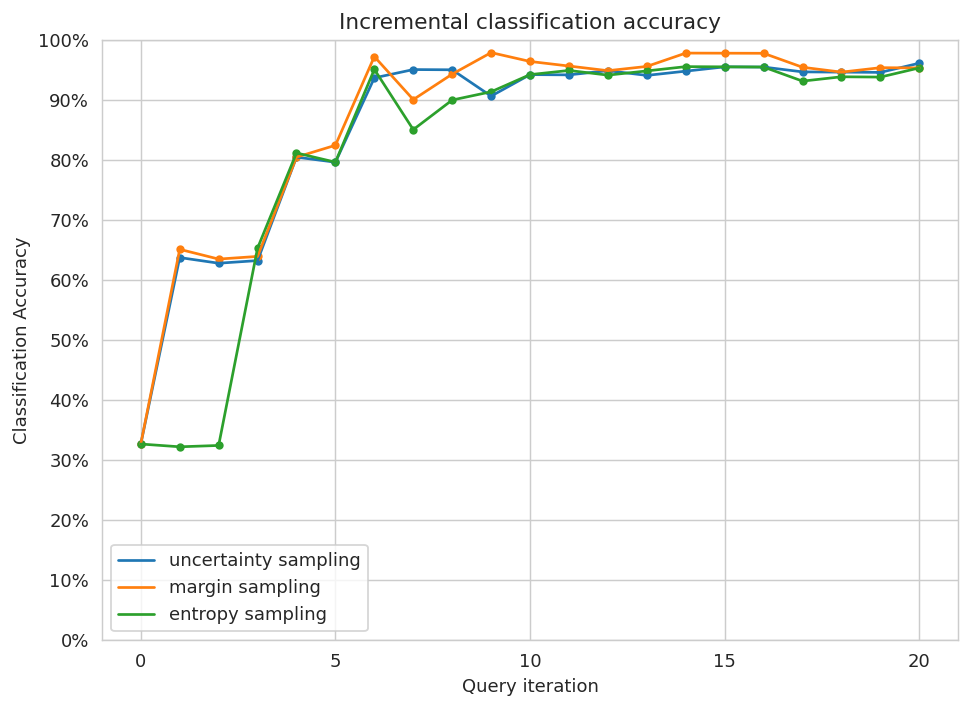

In [182]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

for query_strategy_idx, query_strategy in enumerate(query_strategies):
  performance_history = performance_histories[query_strategy_idx]
  query_strategy_label = query_strategy_labels[query_strategy_idx]
  ax.plot(performance_history, label=query_strategy_label)
  ax.scatter(range(len(performance_history)), performance_history, s=13)

ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')
ax.legend()

plt.show()

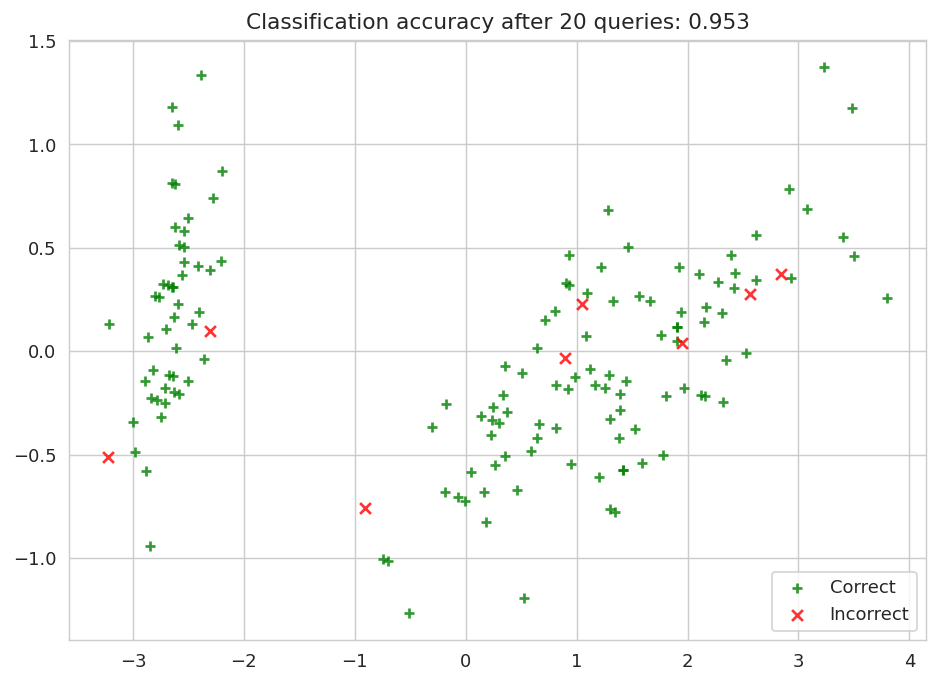

In [183]:
# Isolate the data we'll need for plotting.
predictions = learner.predict(X_raw)
is_correct = (predictions == y_raw)

# Plot our updated classification results once we've trained our learner.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)

ax.scatter(x=x_component[is_correct],  y=y_component[is_correct],  c='g', marker='+', label='Correct',   alpha=8/10)
ax.scatter(x=x_component[~is_correct], y=y_component[~is_correct], c='r', marker='x', label='Incorrect', alpha=8/10)

ax.set_title('Classification accuracy after {n} queries: {final_acc:.3f}'.format(n=N_QUERIES, final_acc=performance_history[-1]))
ax.legend(loc='lower right')

plt.show()

#Szwabe: More reliable comparison of query strategies  (Please comment on the differences)

**Answer**: First of all, we shuffle the data (iris is sorted by class) to make the experiment more "real life". Then we query some example and for each strategy we run the query 20 times. Each startegy chooses the most informative example on its own and we can compare the scores after all queries to see the performance, increases of accuracy, final result etc. This time we also have random_sampling as baseline so we could see how much query strategies are better/worse than the basic case.

In [184]:
from modAL.uncertainty import uncertainty_sampling, margin_sampling, entropy_sampling

In [185]:
#query_strategy=uncertainty_sampling

In [186]:
#np.random.seed(RANDOM_STATE_SEED)
np.random.seed()

In [187]:
not_yet_shuffling_indices = np.arange(y_raw.shape[0])
not_yet_shuffling_indices

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149])

In [188]:
np.random.shuffle(not_yet_shuffling_indices)

In [189]:
shuffling_indices = not_yet_shuffling_indices
shuffling_indices

array([ 42,  32,  26, 100,  76, 128,  15,  34,  68,  27, 111, 106, 118,
        51,  31,  50,  58,  78, 142,  74, 113,  44,  14,  28,  92, 136,
        62,   7, 132,  63,  57, 103,  96,  85, 135, 104, 130,  83,  30,
        38,  18, 109,  70,  67,  11,  37, 105, 127,  16, 139, 112, 134,
       114, 108, 125,  53,   6, 107,  49,  93,  43,  59, 147, 141,   3,
       122,  69,  12,  52, 124,   1, 102, 101, 116,  64,  86,  82,  60,
        46, 148,  95, 140,  97, 110,  45,  73,  71,  39, 115,  10,  65,
        41,  29,  23, 144,  48,  79, 145,  19,  17, 120,  24,  77,  90,
        84,  72,  91,  89,   9,  88, 121, 146, 143,  75, 138,  99,  13,
        47, 123,  61,   8, 137,  35, 131, 117,  21,  56,  87,   4, 126,
        40,  81,  66, 149,  54,   5,  36, 129, 133,  55,  98,  94,  22,
       119,  25,   2,  20,   0,  33,  80])

In [190]:
X_raw = X_raw[shuffling_indices]
y_raw = y_raw[shuffling_indices]

In [191]:
# Isolate our examples for our labeled dataset.
#n_labeled_examples = X_raw.shape[0]

#training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

X_train = X_raw[training_indices]
y_train = y_raw[training_indices]

# Isolate the non-training examples we'll be querying.
X_pool = np.delete(X_raw, training_indices, axis=0)
y_pool = np.delete(y_raw, training_indices, axis=0)

In [192]:
#from sklearn.neighbors import KNeighborsClassifier
#from modAL.models import ActiveLearner

# Specify our core estimator along with it's active learning model.
knn = KNeighborsClassifier(n_neighbors=3)
#learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train)

In [193]:
#learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train, query_strategy=query_strategy)

In [194]:
print("X_train type: ", type(X_train))
print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)

X_train type:  <class 'numpy.ndarray'>
X_train shape:  (3, 4)
y_train shape:  (3,)


In [195]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [196]:
from numpy.random.mtrand import random_sample
#query_strategies = [uncertainty_sampling, margin_sampling, entropy_sampling]
#query_strategy_labels = ["uncertainty sampling", "margin sampling", "entropy sampling"]
query_strategies = [uncertainty_sampling, margin_sampling, entropy_sampling, random_sampling]
query_strategy_labels = ["uncertainty sampling", "margin sampling", "entropy sampling", "random sampling"]

In [197]:
#performance_histories = {"uncertainty sampling":[], "margin sampling":[], "entropy sampling":[]}


In [198]:
performance_histories = {"uncertainty sampling":[], "margin sampling":[], "entropy sampling":[], "random sampling":[]}
number_of_tests = 44

for test_number in range(number_of_tests):

  np.random.shuffle(not_yet_shuffling_indices)
  X_raw = X_raw[shuffling_indices]
  y_raw = y_raw[shuffling_indices]

  #performance_histories = []

  for query_strategy_idx, query_strategy in enumerate(query_strategies):

    query_strategy_label = query_strategy_labels[query_strategy_idx]

    #training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
    training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

    X_train = X_raw[training_indices]
    y_train = y_raw[training_indices]

    # Isolate the non-training examples we'll be querying.
    X_pool = np.delete(X_raw, training_indices, axis=0)
    y_pool = np.delete(y_raw, training_indices, axis=0)

    knn = KNeighborsClassifier(n_neighbors=3)
    learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train, query_strategy=query_strategy)

    N_QUERIES = 20
    #N_QUERIES = 50
    unqueried_score = learner.score(X_pool, y_pool)
    performance_history = [unqueried_score]

    # Allow our model to query our unlabeled dataset for the most
    # informative points according to our query strategy (uncertainty sampling).
    for index in range(N_QUERIES):
      query_index, query_instance = learner.query(X_pool)

      # Teach our ActiveLearner model the record it has requested.
      X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
      print("X type: ", type(X))
      print("X shape: ", X.shape)
      print("y shape: ", y.shape)
      learner.teach(X=X, y=y)

      learner_X_training = learner.X_training
      print("learner_X_training type: ", type(learner_X_training))
      print("learner_X_training shape: ", learner_X_training.shape)
      print("learner_X_training shape: ", learner_X_training.shape)

      # Remove the queried instance from the unlabeled pool.
      X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
      print("X_pool type: ", type(X_pool))
      print("X_pool shape: ", X_pool.shape)
      print("y_pool shape: ", y_pool.shape)

      # Calculate and report our model's accuracy.
      model_accuracy = learner.score(X_pool, y_pool)
      print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))

      #Szwabe: Could we use (and evaluate) another predictive model for the actual ('on-production') predictions in parallel to the active learner? What properties such a system would have if we did use an additional main predictor and the query strategy was random sampling?

      # Save our model's performance for plotting.
      performance_history.append(model_accuracy)
    performance_histories[query_strategy_label].append(performance_history)




X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8409
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.7639
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.7622
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9577
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9097
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9854
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9853
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5455
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.5942
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8472
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8529
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8519
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4966
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5548
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9784
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4521
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5548
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.7724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4306
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.4266
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5755
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5870
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6164
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.9517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9514
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

**Answer**: Yes, we can use a separate production model in parallel with an active learner. This setup is called a dual-model system:

* One model (the active learner) selects what data to label and improve the dataset.

* The second model (the production model) is trained periodically or continuously on the growing labeled dataset to produce stable, reliable predictions for real-world use.

Properties tha this system would have:
* **Stability and Generalization** - random sampling tends to produce a more representative and unbiased labeled dataset, allowing the production model to generalize well to new data.

* **Labeling Efficiency** - random sampling does not prioritize informative data points, so it may require more labeled examples to reach the same level of accuracy.

* **Robustness to Query Bias** - it avoids overfitting to specific areas of the feature space and reduces the risk of query bias.

* **Separation of Roles** - using a separate production model alongside the active learner allows for modular design, where one model focuses on selecting data and the other on producing reliable predictions for real-world use.

* **Implementation Simplicity** - it shouldbe easy to implement, because it doesn’t require fine-tuned strategies or model introspection to decide which data points to label next.

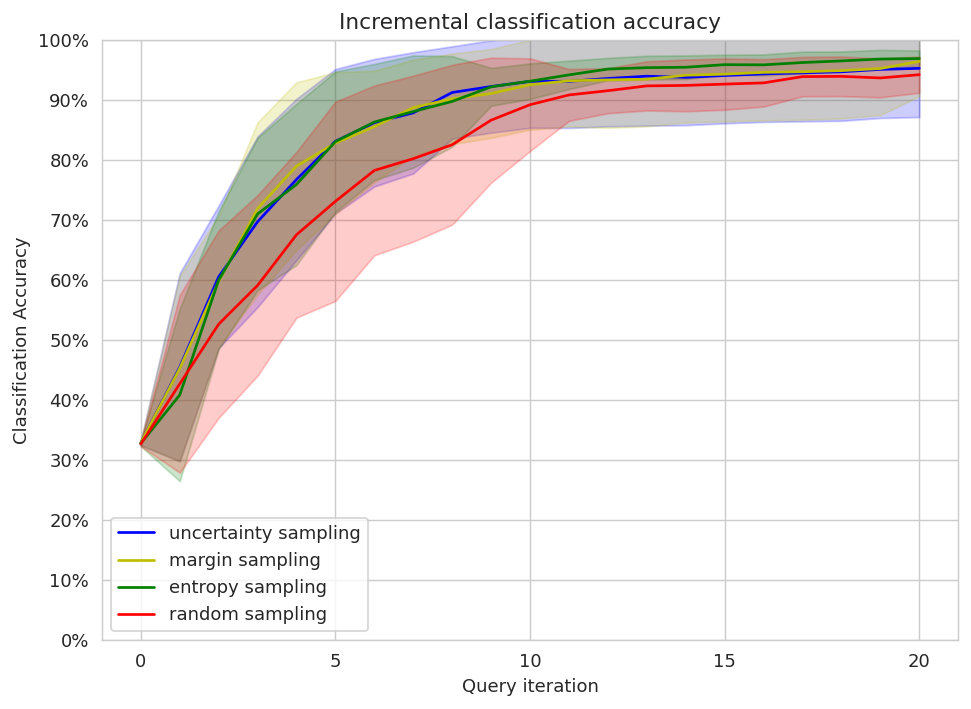

In [199]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
temp_color_letters = ["b", "y", "g", "r"]


for query_strategy_idx, query_strategy in enumerate(query_strategies):
  query_strategy_label = query_strategy_labels[query_strategy_idx]
  performance_history = performance_histories[query_strategy_label]
  #ax.plot(performance_history, label=query_strategy_label)
  #ax.scatter(range(len(performance_history)), performance_history, s=13)
  temp_mean = np.mean(np.array(performance_history), axis=0)
  temp_std = np.std(np.array(performance_history), axis=0)
  temp_color_letter = temp_color_letters[query_strategy_idx]
  x = np.arange(len(temp_mean))
  plt.plot(x, temp_mean, temp_color_letter+"-", label=query_strategy_label)
  plt.fill_between(x, temp_mean - temp_std, temp_mean + temp_std, color=temp_color_letter, alpha=0.2)


ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')
ax.legend()

plt.show()

#Szwabe: Set an appropriate number of test repetitions in order to compare practical value of the four sampling strategies in the most reliable way that is still feasible considering the amount of available time (of the classwork). Compare and comment on the practical value of the strategies.

In [200]:
performance_histories = {"uncertainty sampling":[], "margin sampling":[], "entropy sampling":[], "random sampling":[]}
number_of_tests = 667

for test_number in range(number_of_tests):

  np.random.shuffle(not_yet_shuffling_indices)
  X_raw = X_raw[shuffling_indices]
  y_raw = y_raw[shuffling_indices]

  #performance_histories = []

  for query_strategy_idx, query_strategy in enumerate(query_strategies):

    query_strategy_label = query_strategy_labels[query_strategy_idx]

    #training_indices = np.random.randint(low=0, high=n_labeled_examples + 1, size=3)
    training_indices = np.random.randint(low=0, high=n_labeled_examples, size=3)

    X_train = X_raw[training_indices]
    y_train = y_raw[training_indices]

    # Isolate the non-training examples we'll be querying.
    X_pool = np.delete(X_raw, training_indices, axis=0)
    y_pool = np.delete(y_raw, training_indices, axis=0)

    knn = KNeighborsClassifier(n_neighbors=3)
    learner = ActiveLearner(estimator=knn, X_training=X_train, y_training=y_train, query_strategy=query_strategy)

    N_QUERIES = 20
    #N_QUERIES = 50
    unqueried_score = learner.score(X_pool, y_pool)
    performance_history = [unqueried_score]

    # Allow our model to query our unlabeled dataset for the most
    # informative points according to our query strategy (uncertainty sampling).
    for index in range(N_QUERIES):
      query_index, query_instance = learner.query(X_pool)

      # Teach our ActiveLearner model the record it has requested.
      X, y = X_pool[query_index].reshape(1, -1), y_pool[query_index].reshape(1, )
      print("X type: ", type(X))
      print("X shape: ", X.shape)
      print("y shape: ", y.shape)
      learner.teach(X=X, y=y)

      learner_X_training = learner.X_training
      print("learner_X_training type: ", type(learner_X_training))
      print("learner_X_training shape: ", learner_X_training.shape)
      print("learner_X_training shape: ", learner_X_training.shape)

      # Remove the queried instance from the unlabeled pool.
      X_pool, y_pool = np.delete(X_pool, query_index, axis=0), np.delete(y_pool, query_index)
      print("X_pool type: ", type(X_pool))
      print("X_pool shape: ", X_pool.shape)
      print("y_pool shape: ", y_pool.shape)

      # Calculate and report our model's accuracy.
      model_accuracy = learner.score(X_pool, y_pool)
      print('Accuracy after query {n}: {acc:0.4f}'.format(n=index + 1, acc=model_accuracy))

      # Save our model's performance for plotting.
      performance_history.append(model_accuracy)
    performance_histories[query_strategy_label].append(performance_history)

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8702
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 1.0000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8529
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5821
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5789
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.6327
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 13: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9853
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5347
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8322
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 6: 0.8310
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5655
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8951
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.4759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6042
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.5758
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5725
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5659
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8511
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3082
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8731
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7518
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.8828
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8593
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4966
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.3028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.2979
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8188
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8951
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8235
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8222
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8527
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8516
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.5205
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.8483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8611
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.7692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6138
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5175
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.6074
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6045
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8819
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7410
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7391
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8369
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8369
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.7708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.7692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9371
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 13: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5758
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.8403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8392
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6148
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5581
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5591
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8681
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9853
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 13: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5342
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8129
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8626
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8527
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8731
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5972
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5694
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5175
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8521
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5890
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5448
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5903
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5874
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 15: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 16: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8264
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8112
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5177
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6901
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8958
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 13: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8828
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6074
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3611
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7770
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8662
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8227
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5725
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5581
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9784
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6224
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.8531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8521
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8227
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.7832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.6058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6619
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5903
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.7153
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8681
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8550
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.8527
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.8516
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7958
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5448
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5448
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8657
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7770
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5758
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5448
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5461
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5586
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.5547
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5515
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5224
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.5263
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5227
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6294
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7319
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8321
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8235
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8222
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8392
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6620
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7163
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6434
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8369
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8201
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 1.0000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8681
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8951
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 6: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6350
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6324
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.6296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6269
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.6288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8702
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9097
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6069
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8672
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9784
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.6183
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.6154
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.6202
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9141
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5639
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8898
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5703
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5748
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7842
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8261
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.5368
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.5507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5441
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.7794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7163
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.8125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8112
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7698
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5735
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.6667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.4726
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 3: 0.4690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7626
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8456
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8593
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.6599
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 3: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8298
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6471
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6444
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6418
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.6090
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.6061
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 5: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 6: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.8372
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8359
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8346
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8382
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8951
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7410
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5659
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9306
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.5971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5870
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8284
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8271
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8258
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9021
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5816
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 17: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8169
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7554
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8188
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8550
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8527
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8516
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5735
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.4965
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.4507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6138
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6181
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9097
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9021
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6042
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4384
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6268
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9716
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8088
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8074
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8042
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.3846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8611
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8837
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8828
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.5000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5035
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8451
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8636
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8626
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.6016
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.5580
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5588
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9301
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5822
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8516
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8450
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8898
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8731
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 15: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 16: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 13: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 3: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 4: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 5: 0.8322
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9097
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7554
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8261
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6738
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5735
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6069
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4315
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4966
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 17: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8321
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8309
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.6045
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8162
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8148
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.9371
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9366
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5411
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9154
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9141
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9134
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8521
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8511
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 3: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 4: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4658
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5816
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5435
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5745
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.9301
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8451
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8440
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9853
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.5479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5903
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5874
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5748
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7482
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7464
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6207
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6181
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8672
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5591
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5515
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5821
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8129
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5034
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5809
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.7879
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.7863
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.7846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 16: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 17: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5775
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5816
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8511
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9577
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8661
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.5137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5775
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 14: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 15: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 16: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8529
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.7482
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8321
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8382
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.5664
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5634
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8421
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8636
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after que

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6950
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.7941
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.7704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.7687
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.7669
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5959
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6276
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9021
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8451
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7943
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.7929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.7842
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.7826
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8593
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.3688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5694
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.4857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.4820
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5435
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6301
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8239
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8156
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8129
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8116
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8321
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.7556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9236
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after que

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9301
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9366
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8369
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8264
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8662
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8731
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.8611
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9161
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5586
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8662
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8519
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8647
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.6016
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6164
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9141
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9236
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9161
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6438
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6350
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6324
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6269
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.6212
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8611
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8601
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8592
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.3099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8976
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8601
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7958
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7943
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8592
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9510
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8451
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4863
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8188
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.8385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8372
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8672
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8309
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.7445
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.7426
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.7407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.7388
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9306
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5890
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8042
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.6047
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.7899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.7956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8741
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9716
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9784
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7376
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 17: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 18: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5548
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5310
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9141
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8298
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5106
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5252
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.3077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.8819
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9366
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.4460
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.4420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.4380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9236
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.7643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7554
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8195
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5862
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4861
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8252
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5347
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5315
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9854
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6950
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7626
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5703
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5748
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9161
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 6: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9134
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.7692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9236
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8440
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.5500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.5507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7698
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 15: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 16: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 17: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.5512
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6438
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8662
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5809
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5342
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9645
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7660
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7391
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8148
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.7863
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8837
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8188
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6131
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.5755
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5942
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5435
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.5938
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8806
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8872
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8258
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8321
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8310
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.8440
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.8429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8788
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.5906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.5769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5703
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5669
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5616
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3862
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.7014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9154
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.6061
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5874
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5816
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8984
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8976
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5310
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6170
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.5682
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5649
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5581
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5870
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5839
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5882
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5486
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5532
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5468
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.5809
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5821
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.5692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 19: 0.5659
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9134
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9306
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.7589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8201
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8261
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6547
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6522
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.7518
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.7778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5882
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7958
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5674
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5532
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5674
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5862
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9927
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9510
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9433
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.6077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8873
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5655
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.4861
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8252
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8239
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5862
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8819
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.4828
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4792
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5245
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4247
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6207
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.4861
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5781
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5669
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.5342
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6069
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5524
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6099
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8392
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5793
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5833
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5804
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8456
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9055
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8440
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.5882
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8369
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6232
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6204
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.6045
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.5890
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8593
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8731
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.6031
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8623
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8613
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9021
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5252
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5217
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9231
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5532
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8042
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8732
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.4789
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.5929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9853
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8992
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8898
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9504
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8633
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8905
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9141
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9134
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9070
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9062
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8906
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8819
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5809
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5954
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.5971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7465
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7447
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5177
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5468
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5435
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.4552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5694
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.5594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.5986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.5625
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5591
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9302
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9179
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8227
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8056
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.5970
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5940
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5909
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.6507
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6454
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.7328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.7308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.7287
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.6953
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (147, 4)
y_pool shape:  (147,)
Accuracy after query 1: 0.3265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 2: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.7868
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8759
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8815
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8657
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.6127
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5942
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5882
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.7986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8029
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6547
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9297
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8201
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'num

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5401
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5735
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.5891
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9118
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9111
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9286
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9783
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8521
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8511
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9313
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9308
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9922
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3125
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9375
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.8209
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8864
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8855
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5745
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5108
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9014
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.5500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5870
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5547
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9265
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8143
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8129
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6043
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6087
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9149
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8227
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5448
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5972
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5862
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5693
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5809
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5778
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9237
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.5342
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5972
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8667
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.5802
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5581
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5547
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5736
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5703
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5669
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9007
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6377
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.7059
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8955
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.5969
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5703
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5669
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9437
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9568
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8696
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.6301
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 3: 0.9655
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 4: 0.9653
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 5: 0.9510
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6620
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.6596
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.5912
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5882
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5896
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9242
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9225
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9220
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9847
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9843
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.4589
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5724
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.5556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6503
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6479
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8768
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.5865
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.5878
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.5846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8662
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8723
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8993
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.5563
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5532
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5540
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9191
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9852
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9850
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9466
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9924
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9281
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8169
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8156
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8849
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9424
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8467
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9213
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.9296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8797
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8913
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9420
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9124
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9779
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.8740
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.7943
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.7571
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6619
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6522
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9197
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8832
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8824
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9846
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9845
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.5857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5942
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 10: 0.9058
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 11: 0.9343
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 12: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9084
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9077
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.7708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.9510
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8921
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8986
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.8978
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8841
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9380
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6575
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'nump

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.8652
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.9714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 9: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9638
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8529
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9259
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.5814
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.5859
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.5827
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.4476
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.4930
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.5177
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5887
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5580
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9275
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.3194
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 2: 0.5379
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6250
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.6224
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6268
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9643
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_train

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9248
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3151
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9453
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9457
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9493
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5725
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5956
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.8550
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8605
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.8594
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6483
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.8944
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6449
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.6423
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6397
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.7591
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8971
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3172
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8857
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9640
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9051
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9044
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9254
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9844
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 6: 0.9366
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 7: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 8: 0.9214
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_trainin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.6324
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6296
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6269
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.6241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9160
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9154
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8936
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training sh

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.9071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9137
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9407
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9394
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9291
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9028
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.6170
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6071
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6187
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.5290
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.5294
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5926
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.8519
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9104
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.8561
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.7676
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8440
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8429
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8777
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.6496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6471
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8963
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8794
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.8489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8551
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9559
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9008
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.9574
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.9357
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9353
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.8750
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.8889
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.8897
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9037
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9030
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9098
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.5147
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.5185
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.5522
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.5489
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8947
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9323
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9091
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9462
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9851
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 5: 0.9155
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9362
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8929
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9712
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8881
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6414
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8472
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5793
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9773
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.8722
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9615
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9612
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.5603
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.5714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.5899
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.5870
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9710
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9556
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9398
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.6204
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6370
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6345
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6458
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8705
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9416
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9412
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6159
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.5985
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class '

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.6103
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.6074
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.6045
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 14: 0.9023
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9015
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9389
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9385
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.8403
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8601
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9236
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.7746
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.8085
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8714
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.8500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9348
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 9: 0.9565
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9635
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9632
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9481
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9328
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9173
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9318
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9542
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9766
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9764
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.6644
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.6597
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training sha

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.6475
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.7319
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9270
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lea

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 10: 0.8686
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9338
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9333
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9478
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9704
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9776
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9699
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9848
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9618
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9538
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9535
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9531
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9528
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.6552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training shape:  (6, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (144, 4)
y_pool shape:  (144,)
Accuracy after query 3: 0.9167
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 4: 0.6573
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.6549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.6525
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.6500
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.6115
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.6304
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9708
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9706
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.8417
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.8406
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (15, 4)
learner_X_training shape:  (15, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (135, 4)
y_pool shape:  (135,)
Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9701
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9774
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.8939
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.8931
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.8923
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.8915
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 17: 0.9692
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9690
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (22, 4)
learner_X_training shape:  (22, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 19: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9685
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (128, 4)
y_pool shape:  (128,)
Accuracy after query 20: 0.9688
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3288
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.5517
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (6, 4)
learner_X_training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 19: 0.9609
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (23, 4)
learner_X_training shape:  (23, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (127, 4)
y_pool shape:  (127,)
Accuracy after query 20: 0.9606
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (4, 4)
learner_X_training shape:  (4, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (146, 4)
y_pool shape:  (146,)
Accuracy after query 1: 0.3219
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (5, 4)
learner_X_training shape:  (5, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (145, 4)
y_pool shape:  (145,)
Accuracy after query 2: 0.3241
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learne

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 3: 0.9097
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (7, 4)
learner_X_training shape:  (7, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (143, 4)
y_pool shape:  (143,)
Accuracy after query 4: 0.8811
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (8, 4)
learner_X_training shape:  (8, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (142, 4)
y_pool shape:  (142,)
Accuracy after query 5: 0.8803
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (9, 4)
learner_X_training shape:  (9, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (141, 4)
y_pool shape:  (141,)
Accuracy after query 6: 0.9078
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 6: 0.8582
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (10, 4)
learner_X_training shape:  (10, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (140, 4)
y_pool shape:  (140,)
Accuracy after query 7: 0.8786
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (11, 4)
learner_X_training shape:  (11, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (139, 4)
y_pool shape:  (139,)
Accuracy after query 8: 0.9065
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9203
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
lear

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 8: 0.9496
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (12, 4)
learner_X_training shape:  (12, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (138, 4)
y_pool shape:  (138,)
Accuracy after query 9: 0.9130
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (13, 4)
learner_X_training shape:  (13, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (137, 4)
y_pool shape:  (137,)
Accuracy after query 10: 0.9562
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (14, 4)
learner_X_training shape:  (14, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (136, 4)
y_pool shape:  (136,)
Accuracy after query 11: 0.9485
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
le

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.6000
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9627
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9624
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9621
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9474
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9697
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9771
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 15: 0.9470
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (19, 4)
learner_X_training shape:  (19, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (131, 4)
y_pool shape:  (131,)
Accuracy after query 16: 0.9695
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (20, 4)
learner_X_training shape:  (20, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (130, 4)
y_pool shape:  (130,)
Accuracy after query 17: 0.9769
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (21, 4)
learner_X_training shape:  (21, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (129, 4)
y_pool shape:  (129,)
Accuracy after query 18: 0.9767
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Accuracy after query 12: 0.9630
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (16, 4)
learner_X_training shape:  (16, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (134, 4)
y_pool shape:  (134,)
Accuracy after query 13: 0.9552
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (17, 4)
learner_X_training shape:  (17, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (133, 4)
y_pool shape:  (133,)
Accuracy after query 14: 0.9549
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)
learner_X_training type:  <class 'numpy.ndarray'>
learner_X_training shape:  (18, 4)
learner_X_training shape:  (18, 4)
X_pool type:  <class 'numpy.ndarray'>
X_pool shape:  (132, 4)
y_pool shape:  (132,)
Accuracy after query 15: 0.9545
X type:  <class 'numpy.ndarray'>
X shape:  (1, 4)
y shape:  (1,)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

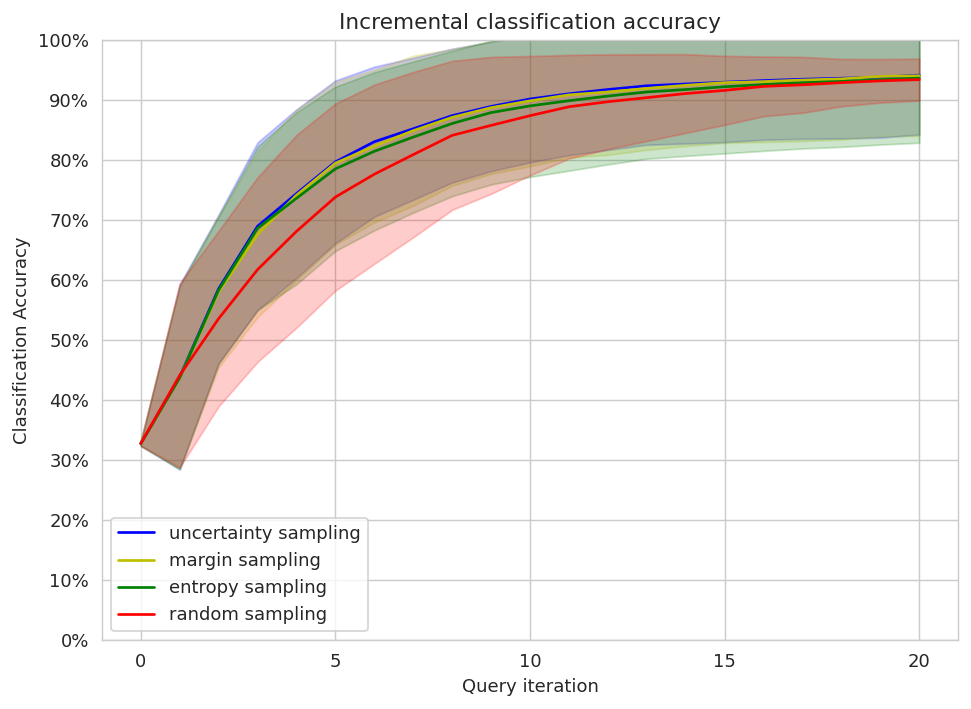

In [201]:
# Plot our performance over time.
fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
temp_color_letters = ["b", "y", "g", "r"]


for query_strategy_idx, query_strategy in enumerate(query_strategies):
  query_strategy_label = query_strategy_labels[query_strategy_idx]
  performance_history = performance_histories[query_strategy_label]
  #ax.plot(performance_history, label=query_strategy_label)
  #ax.scatter(range(len(performance_history)), performance_history, s=13)
  temp_mean = np.mean(np.array(performance_history), axis=0)
  temp_std = np.std(np.array(performance_history), axis=0)
  temp_color_letter = temp_color_letters[query_strategy_idx]
  x = np.arange(len(temp_mean))
  plt.plot(x, temp_mean, temp_color_letter+"-", label=query_strategy_label)
  plt.fill_between(x, temp_mean - temp_std, temp_mean + temp_std, color=temp_color_letter, alpha=0.2)


ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))

ax.set_ylim(bottom=0, top=1)
ax.grid(True)

ax.set_title('Incremental classification accuracy')
ax.set_xlabel('Query iteration')
ax.set_ylabel('Classification Accuracy')
ax.legend()

plt.show()

**Answer**: In our case we can see that entropy sampling, margin sampling and uncertainity sampling have comparable performance on most stages of the experiment and after 15 iterations their accuracies aren't increased with more queries ran. Only random sampling has worse performance on the beggining (by let's say 5 perc. points) but eventually it more less achieves the performance of the other 3 query strategies.

**Random Sampling**

Random sampling is the baseline strategy. It’s simple, unbiased, and guarantees a representative labeled dataset in expectation if enough samples are collected. However, it doesn’t prioritize informative data points, so it often requires more labeled data to reach high accuracy. Despite its inefficiency, it’s competitive in practice when data is well-distributed or when labeling costs are low. It’s also robust and avoids overfitting to hard-to-classify regions.

**Least Confident Sampling**

Least confident sampling queries the instances for which the model's top predicted class has the lowest confidence. This strategy is simple and often effective, especially in early stages when the model has limited knowledge. It tends to quickly identify decision boundaries and boost model performance with fewer queries. However, it can be overly focused on outliers or noisy samples, especially if the model is poorly calibrated or undertrained.

**Entropy Sampling**

Entropy-based sampling measures the overall uncertainty in the predicted class distribution. It’s considered a more holistic uncertainty metric than just the top prediction confidence. This often leads to more informative and balanced selections, particularly in multi-class problems. In practice, it performs slightly better than least confident in some cases, but it’s also slightly more computationally expensive and may still suffer from focusing too much on ambiguous or noisy points.

**Margin Sampling**

Margin sampling selects points where the model has a small difference between the top two predicted class probabilities, which targets points near the decision boundary. It’s particularly effective in binary or low-class-count problems, like the Iris dataset. It often performs similarly or better than least confident sampling and is relatively robust. Like other uncertainty-based strategies, its performance depends on the model's ability to estimate uncertainty accurately.

In [202]:
!pip freeze

absl-py==1.4.0
accelerate==1.7.0
aiofiles==24.1.0
aiohappyeyeballs==2.6.1
aiohttp==3.11.15
aiosignal==1.3.2
alabaster==1.0.0
albucore==0.0.24
albumentations==2.0.8
ale-py==0.11.1
altair==5.5.0
annotated-types==0.7.0
antlr4-python3-runtime==4.9.3
anyio==4.9.0
argon2-cffi==25.1.0
argon2-cffi-bindings==21.2.0
array_record==0.7.2
arviz==0.21.0
astropy==7.1.0
astropy-iers-data==0.2025.6.9.14.9.37
astunparse==1.6.3
atpublic==5.1
attrs==25.3.0
audioread==3.0.1
autograd==1.8.0
babel==2.17.0
backcall==0.2.0
backports.tarfile==1.2.0
beautifulsoup4==4.13.4
betterproto==2.0.0b6
bigframes==2.6.0
bigquery-magics==0.9.0
bleach==6.2.0
blinker==1.9.0
blis==1.3.0
blobfile==3.0.0
blosc2==3.3.4
bokeh==3.7.3
Bottleneck==1.4.2
bqplot==0.12.45
branca==0.8.1
build==1.2.2.post1
CacheControl==0.14.3
cachetools==5.5.2
catalogue==2.0.10
certifi==2025.4.26
cffi==1.17.1
chardet==5.2.0
charset-normalizer==3.4.2
chex==0.1.89
clarabel==0.11.1
click==8.2.1
cloudpathlib==0.21.1
cloudpickle==3.1.1
cmake==3.31.6
cmdstanpy